In [2]:
import numpy as np
import moviepy.editor as mp
import opensmile
import pandas as pd
import os
import sys
import tensorflow as tf
import librosa
import librosa.display
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import collections
import matplotlib
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import svm #Import svm model
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
from sklearn.metrics import confusion_matrix,roc_curve,roc_auc_score,accuracy_score,classification_report
import joblib
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score 

# Loading the custom utils.py file

In [3]:
import importlib
import utils as utils
importlib.reload(utils)#reload to ensure the latest version is used

<module 'utils' from 'd:\\Speech Emotion Recognition\\Speech-Emotion-Detection\\code\\utils.py'>

In [23]:
X_ravdess, speaker, file_name, _ = utils.load_wav_features("C:\\Users\\HP\\Downloads\\Ravdess\\audio_speech_actors_01-24")

Extracting the emotions and utterance labels from the data

In [24]:
emotions, utterances= utils.process_ravdess(file_name)

We now do the speaker to speaker normalization

In [25]:
scaler = utils.StandardScaleNormalizer()
X_ravdess_norm = scaler.fit_transform(X_ravdess, speaker)

In [8]:
dataLoader = utils.CustomDataLoader(X_ravdess_norm, speaker, emotions, utterances)

In [9]:
if os.path.isdir("D:\\Speech Emotion Recognition\\Speech-Emotion-Detection\\models\\ravdess_updated"):
    print("Directory exists")
else:
    os.mkdir("D:\\Speech Emotion Recognition\\Speech-Emotion-Detection\\models\\ravdess_updated")

Directory exists


In [10]:
# from sklearn.model_selection import GridSearchCV
# train_accuracy_list = []
# test_accuracy_list = []
# logo = utils.leave_one_speaker_out(dataLoader)
# for data_train, data_test, emotion_train, emotion_test, utt_train, utt_test, speaker_train, speaker_test in iter(logo):
#     print("Training with " + speaker_test[0] +" left out...")
#     ml = svm.SVC(probability = True) 
    
#     # defining parameter range

#     param_grid = {'C': [ 1, 10, 100, 1000,10000], 
#                 'gamma': [5,1,0.1,0.01,0.001,0.0001],
#                 'kernel': ['rbf']} 

    
#     grid = GridSearchCV(ml, param_grid, refit = True, verbose = 1,cv=10)
    
#     # fitting the model for grid search
#     grid_search=grid.fit(data_train, emotion_train)

#     #saving the model
#     joblib.dump(grid_search, 'D:\\Speech Emotion Recognition\\Speech-Emotion-Detection\\models\\ravdess\\svm_ravdess_{}.pkl'.format(speaker_test[0]))
#     y_test_hat=grid_search.predict(data_test)
#     test_accuracy=accuracy_score(emotion_test,y_test_hat)*100
#     accuracy = grid_search.best_score_ *100
#     print("Accuracy for training dataset with tuning is : {:.2f}% and test accuracy : {:.2f}".format(accuracy, test_accuracy) )
#     train_accuracy_list.append(accuracy)
#     test_accuracy_list.append(test_accuracy)

We aim to split the RAVDESS data into 4 folds and define an SVM using these folds:

In [11]:
# Define the mapping of speaker IDs to folds
fold_mapping = {
    'Actor_01': 1, 'Actor_02': 1, 'Actor_03': 1, 'Actor_04': 1,
    'Actor_05': 2, 'Actor_06': 2, 'Actor_07': 2, 'Actor_08': 2,
    'Actor_09': 3, 'Actor_10': 3, 'Actor_11': 3, 'Actor_12': 3,
    'Actor_13': 4, 'Actor_14': 4, 'Actor_15': 4, 'Actor_16': 4,
    'Actor_17': 5, 'Actor_18': 5, 'Actor_19': 5, 'Actor_20': 5,
		'Actor_21': 6, 'Actor_22': 6, 'Actor_23': 6, 'Actor_24': 6,
}

In [12]:
ravdess_folds = [f"Fold {fold_mapping.get(x)}" for x in dataLoader.speaker_ids]

In [34]:
from sklearn.model_selection import LeaveOneGroupOut
from sklearn.model_selection import GridSearchCV
logo = LeaveOneGroupOut()
fold_generated = logo.split(X_ravdess_norm, emotions, ravdess_folds)

param_grid = {'C': [ 1, 10, 100, 1000,10000], 
                'gamma': [5,1,0.1,0.01,0.001,0.0001],
                'kernel': ['rbf']}

ml = svm.SVC(probability = True) 
grid = GridSearchCV(ml, param_grid, refit = True, verbose = 1,cv=fold_generated)
    
    # fitting the model for grid search
grid_search=grid.fit(X_ravdess_norm, emotions)

Fitting 6 folds for each of 30 candidates, totalling 180 fits


In [35]:
# Print the best hyperparameters found
print("Tuned SVM Parameters: {}".format(grid_search.best_params_))
# Print the evaluation score of the best hyperparameters
print("Best SVM model average cross-validation accuracy: {:.2f}%".format(grid_search.best_score_*100))

Tuned SVM Parameters: {'C': 1, 'gamma': 0.01, 'kernel': 'rbf'}
Best SVM model average cross-validation accuracy: 62.78%


# RAVDESS results for eGEMAPS

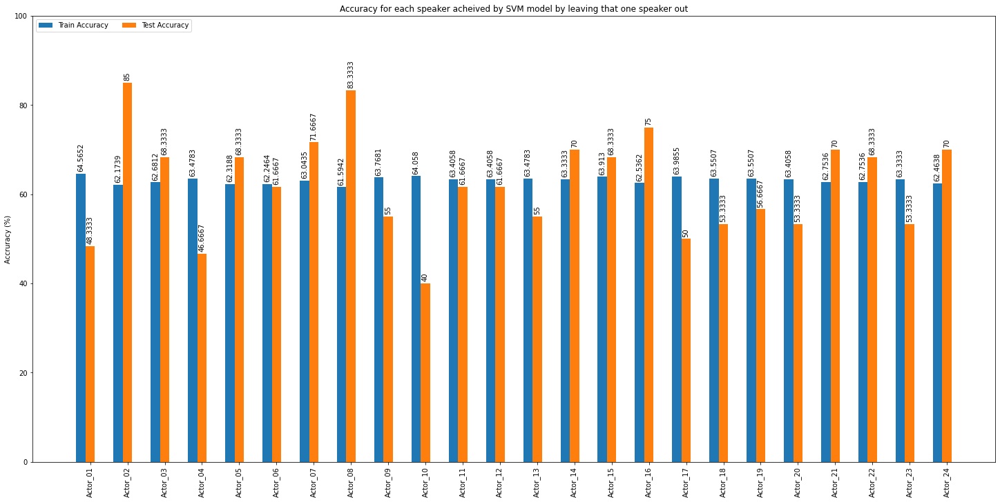

In [74]:
# species = np.sort(list(set(dataLoader.speaker_ids)))
# penguin_means = {
#     'Train Accuracy': train_accuracy_list,
#     'Test Accuracy': test_accuracy_list,
# }

# x = np.arange(len(species))  # the label locations
# width = 0.25  # the width of the bars
# multiplier = 0

# fig, ax = plt.subplots(figsize = (20, 10), layout='constrained')

# for attribute, measurement in penguin_means.items():
#     offset = width * multiplier
#     rects = ax.bar(x + offset, measurement, width, label=attribute)
#     ax.bar_label(rects, padding=3, rotation=90)
#     multiplier += 1

# # Add some text for labels, title and custom x-axis tick labels, etc.
# ax.set_ylabel('Accruracy (%)')
# ax.set_title('Accuracy for each speaker acheived by SVM model by leaving that one speaker out')
# ax.set_xticks(x + width, species, rotation=90)
# ax.legend(loc='upper left', ncol =2)
# ax.set_ylim(0, 100)

# plt.show()

In [184]:
ravdess_prob_score = grid_search.predict_proba(X_ravdess_norm)

In [185]:
labels_ravdess = np.sort(['neutral', 'calm', 'happy', 'sad', 'angry', 'fearful', 'disgust', 'surprised'])
predictions = [labels_ravdess[i] for i in np.argmax(ravdess_prob_score, axis=1)]

In [186]:
df_labels_new = pd.DataFrame()
df_labels_new["RAVDESS Prediction"] = predictions
df_labels_new["RAVDESS True"] = emotions
df_labels_new_comp = pd.crosstab(df_labels_new["RAVDESS Prediction"] , df_labels_new["RAVDESS True"])

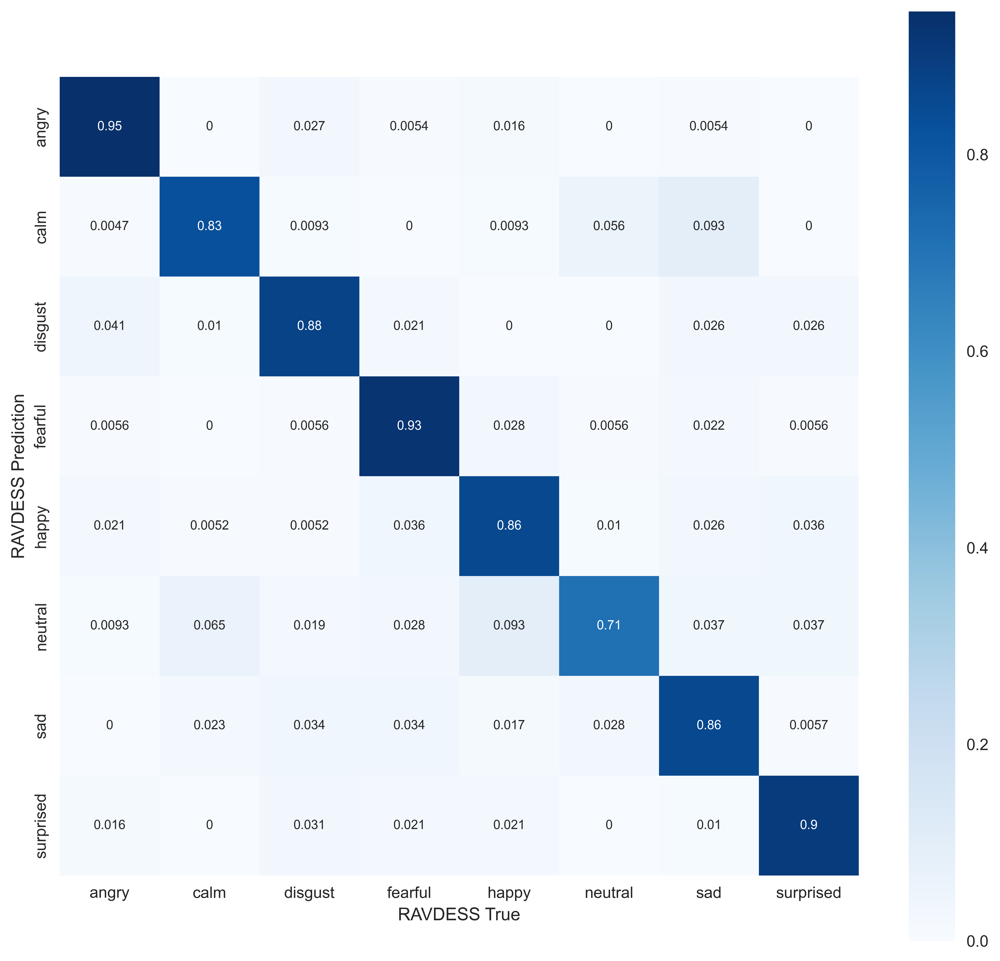

In [188]:
plt.rcParams['figure.dpi'] = 600
plt.figure(figsize=(10,10))
sns.heatmap(df_labels_new_comp/df_labels_new_comp.sum(axis=1)[:, np.newaxis], cmap="Blues",square= True, annot=True, annot_kws={'size': 8})
plt.savefig("D:\\Speech Emotion Recognition\\Speech-Emotion-Detection\\figures\\ravdess_heatmap.png")

# Finding out the feature importances

In [4]:
smile = opensmile.Smile(feature_set=opensmile.FeatureSet.eGeMAPSv02, feature_level=opensmile.FeatureLevel.Functionals) # getting the smile object
smile.feature_names # getting the names of the features

['F0semitoneFrom27.5Hz_sma3nz_amean',
 'F0semitoneFrom27.5Hz_sma3nz_stddevNorm',
 'F0semitoneFrom27.5Hz_sma3nz_percentile20.0',
 'F0semitoneFrom27.5Hz_sma3nz_percentile50.0',
 'F0semitoneFrom27.5Hz_sma3nz_percentile80.0',
 'F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2',
 'F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope',
 'F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope',
 'F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope',
 'F0semitoneFrom27.5Hz_sma3nz_stddevFallingSlope',
 'loudness_sma3_amean',
 'loudness_sma3_stddevNorm',
 'loudness_sma3_percentile20.0',
 'loudness_sma3_percentile50.0',
 'loudness_sma3_percentile80.0',
 'loudness_sma3_pctlrange0-2',
 'loudness_sma3_meanRisingSlope',
 'loudness_sma3_stddevRisingSlope',
 'loudness_sma3_meanFallingSlope',
 'loudness_sma3_stddevFallingSlope',
 'spectralFlux_sma3_amean',
 'spectralFlux_sma3_stddevNorm',
 'mfcc1_sma3_amean',
 'mfcc1_sma3_stddevNorm',
 'mfcc2_sma3_amean',
 'mfcc2_sma3_stddevNorm',
 'mfcc3_sma3_amean',
 'mfcc3_sma3_stddevNorm',
 'mfcc4_

We need to linear kernell to found out the most important features of the svm trained kernel. Thus, in our parameter grid search method, we only fit for linear kernel with varying C and gamm hyperparameters

In [13]:
from sklearn.model_selection import LeaveOneGroupOut
from sklearn.model_selection import GridSearchCV
logo = LeaveOneGroupOut()
fold_generated = logo.split(X_ravdess_norm, emotions, ravdess_folds)

param_grid = {'C': [ 1, 10, 100, 1000,10000], 
                'gamma': [5,1,0.1,0.01,0.001,0.0001],
                'kernel': ['linear']}

ml = svm.SVC(probability = True) 
grid = GridSearchCV(ml, param_grid, refit = True, verbose = 1,cv=fold_generated)
    
    # fitting the model for grid search
grid_search=grid.fit(X_ravdess_norm, emotions)

Fitting 6 folds for each of 30 candidates, totalling 180 fits


In [14]:
# Print the best hyperparameters found
print("Tuned SVM Parameters: {}".format(grid_search.best_params_))
# Print the evaluation score of the best hyperparameters
print("Best SVM model average cross-validation accuracy: {:.2f}%".format(grid_search.best_score_*100))

Tuned SVM Parameters: {'C': 1, 'gamma': 5, 'kernel': 'linear'}
Best SVM model average cross-validation accuracy: 57.50%


In [23]:
#https://stackoverflow.com/questions/41592661/determining-the-most-contributing-features-for-svm-classifier-in-sklearn
def f_importances(coef, names):
    imp = coef
    imp,names = zip(*sorted(zip(imp,names)))
    plt.figure(figsize = (10, 20))
    plt.barh(range(len(names)), imp, align='center')
    plt.yticks(range(len(names)), names)
    plt.show()

In [28]:
grid_search.best_estimator_.coef_[0]

array([ 0.02386579,  0.06706109,  0.0574384 ,  0.04456091,  0.07085247,
       -0.13411334, -0.16390008,  0.09433921, -0.08923683,  0.11628252,
        0.12922628,  0.37874258,  0.20820745, -0.03771194,  0.13706973,
        0.1351025 ,  0.2767969 ,  0.2565297 ,  0.2136573 ,  0.25165166,
        0.06884291,  0.10419194,  0.09252646, -0.03096429,  0.10798422,
        0.09186109, -0.06347768,  0.02476691,  0.02683365,  0.14145624,
        0.18613069, -0.0413904 ,  0.1239456 , -0.29203785, -0.3655277 ,
        0.20675455,  0.03904437,  0.19200422,  0.05443877,  0.05211104,
        0.04333465,  0.01283245, -0.16269409, -0.01600925,  0.02322878,
       -0.06105549, -0.02047064,  0.13254249, -0.04425459,  0.21626755,
       -0.01795125, -0.02330483, -0.13482842, -0.00325112, -0.19099376,
        0.13456742, -0.01642061, -0.03299963,  0.05673189, -0.13159094,
        0.00333519,  0.19210285,  0.26250748,  0.01607107, -0.37049737,
       -0.37064703,  0.1017337 , -0.10792914,  0.09055793, -0.04

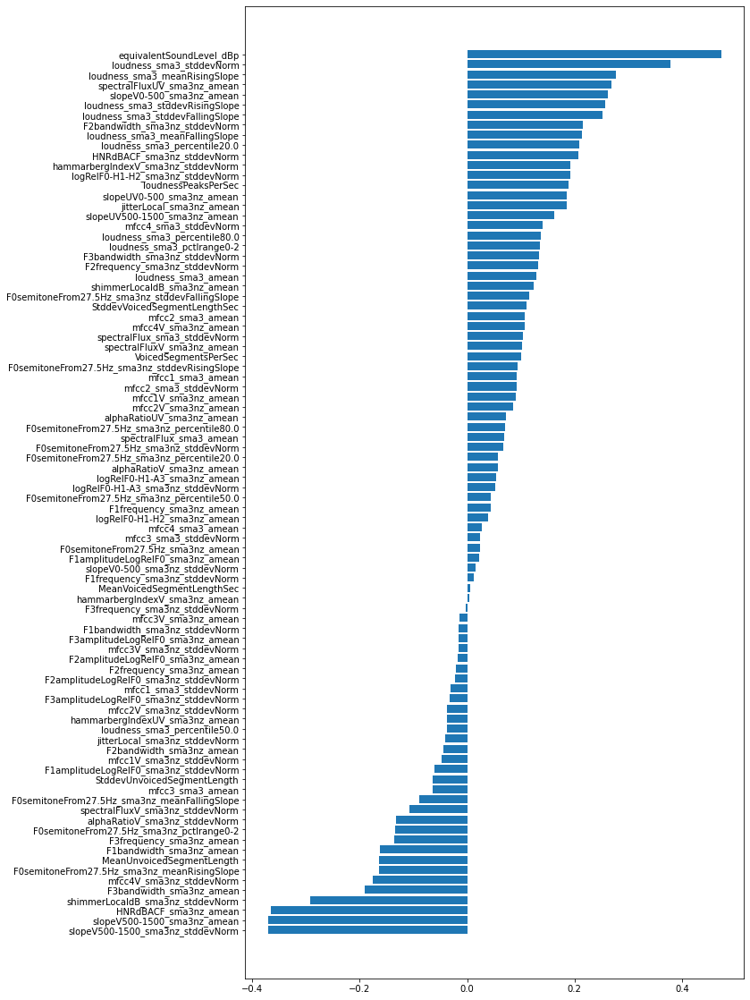

In [29]:
f_importances(grid_search.best_estimator_.coef_[0], smile.feature_names)

# Clustering of the hindi dataset

## Loading the hindi dataset

In [20]:
X_hindi, speaker_hindi, file_name, _ = utils.load_wav_features("D:\\Speech Emotion Recognition\\Speech-Emotion-Detection\\data\\trimmed_hindi_wav\\")

In [21]:
attitude, utterances_hindi= utils.process_hindi(file_name)

In [22]:
scaler_hindi = utils.StandardScaleNormalizer()
X_hindi_norm = scaler_hindi.fit_transform(X_hindi, speaker_hindi)

In [13]:
hindi_data_loader = utils.CustomDataLoader(X_hindi_norm, speaker_hindi, attitude, utterances_hindi)

In [7]:
# trained_ravdess_model_ensemble = utils.load_svm_ensemble(model_path=r"D:\\Speech Emotion Recognition\\Speech-Emotion-Detection\\models\\ravdess\\")

Loading model with s_Actor_01 left out while training
Loading model with s_Actor_02 left out while training
Loading model with s_Actor_03 left out while training
Loading model with s_Actor_04 left out while training
Loading model with s_Actor_05 left out while training
Loading model with s_Actor_06 left out while training
Loading model with s_Actor_07 left out while training
Loading model with s_Actor_08 left out while training
Loading model with s_Actor_09 left out while training
Loading model with s_Actor_10 left out while training
Loading model with s_Actor_11 left out while training
Loading model with s_Actor_12 left out while training
Loading model with s_Actor_13 left out while training
Loading model with s_Actor_14 left out while training
Loading model with s_Actor_15 left out while training
Loading model with s_Actor_16 left out while training
Loading model with s_Actor_17 left out while training
Loading model with s_Actor_18 left out while training
Loading model with s_Actor_1

In [13]:
# prob_sum = trained_ravdess_model_ensemble[0].predict_proba(hindi_data_loader.data)
# for i in range(1, 24):
#     prob_sum+=trained_ravdess_model_ensemble[i].predict_proba(hindi_data_loader.data)
# prob_sum /=24.0

In [165]:
prob_sum = grid_search.predict_proba(hindi_data_loader.data)

In [166]:
labels_ravdess = np.sort(['neutral', 'calm', 'happy', 'sad', 'angry', 'fearful', 'disgust', 'surprised'])
predictions = [labels_ravdess[i] for i in np.argmax(prob_sum, axis=1)]

In [167]:
df_labels_new = pd.DataFrame()
df_labels_new["Hindi Attitude"] = attitude
df_labels_new["RAVDESS Labels"] = predictions
df_labels_new_comp = pd.crosstab(df_labels_new["Hindi Attitude"], df_labels_new["RAVDESS Labels"])

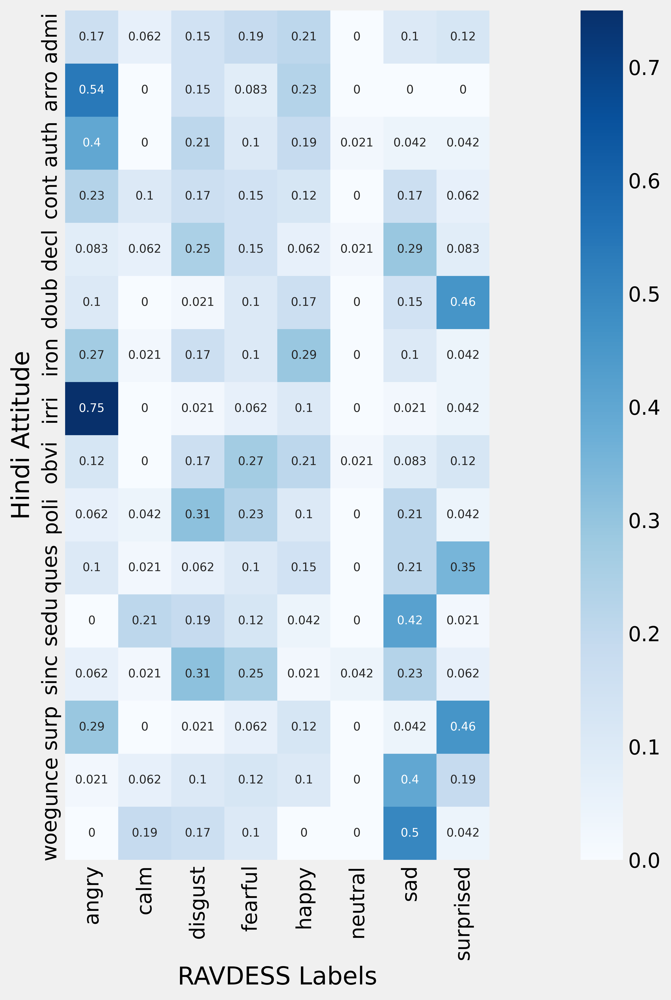

In [173]:
plt.rcParams['figure.dpi'] = 600
plt.figure(figsize=(20,10))
sns.heatmap(df_labels_new_comp/df_labels_new_comp.sum(axis=1)[:, np.newaxis], cmap="Blues",square= True, annot=True, annot_kws={'size': 8})
plt.savefig("D:\\Speech Emotion Recognition\\Speech-Emotion-Detection\\figures\\final_grouping_hindi_to_ravde.png")

# Cosine similarity

In [60]:
def get_similarity_matrix(x1,y1,x2,y2, xlabel, ylabel, similarity_measure,figsize=(16,4)):
    # Get unique class labels
    unique_classes1 = np.unique(y1)
    unique_classes2 = np.unique(y2)
    # Calculate similarity measure between different classes
    similarity_matrix = np.zeros((len(unique_classes2), len(unique_classes1)))
    for i, class_i in enumerate(unique_classes2):#enumerate(['fea']):# enumerate(unique_classes_emo):
        for j, class_j in enumerate(unique_classes1):
            X_class_i = x2[y2 == class_i]
            X_class_j = x1[y1 == class_j]
            # Calculate cosine similarity between the class samples
            similarity = np.mean(cosine_similarity(X_class_i, X_class_j))
            # Calculate Euclidean distance between the class samples
            # similarity = np.mean(euclidean_distances(X_class_i, X_class_j))
            similarity_matrix[i, j] = similarity
    plt.figure(figsize=figsize)
    # Create a heatmap using seaborn
    sns.heatmap(similarity_matrix, cmap="Blues", annot=True, xticklabels=unique_classes1, yticklabels=unique_classes2)
    # Set the axis labels and title
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title("Similarity plot between " + ylabel + " and " + xlabel +" using " + similarity_measure)
    plt.show()
    return similarity_matrix

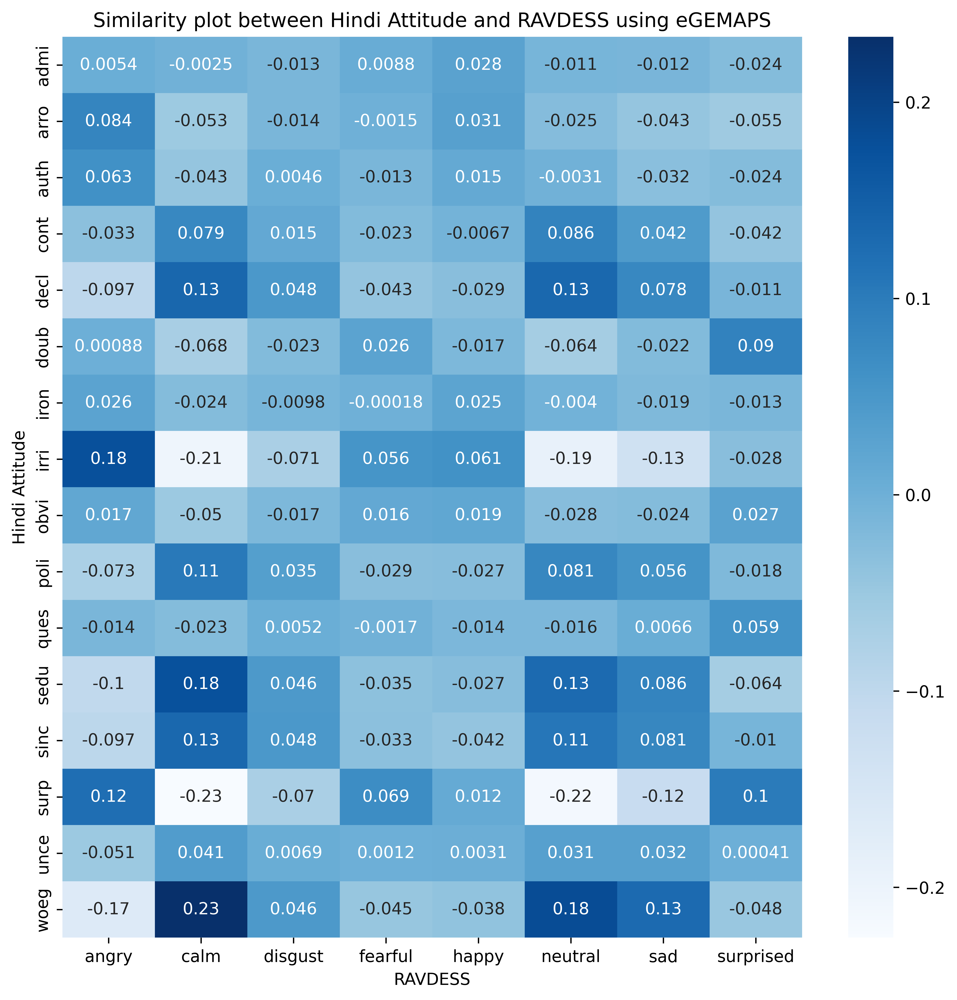

array([[ 5.38547756e-03, -2.52895546e-03, -1.33882295e-02,
         8.84513184e-03,  2.78969668e-02, -1.05453990e-02,
        -1.17193442e-02, -2.40930356e-02],
       [ 8.41450393e-02, -5.31689413e-02, -1.36286533e-02,
        -1.50556280e-03,  3.08109056e-02, -2.51566935e-02,
        -4.34425026e-02, -5.50524443e-02],
       [ 6.29272386e-02, -4.29944135e-02,  4.64114873e-03,
        -1.27713606e-02,  1.45258950e-02, -3.08607682e-03,
        -3.15188803e-02, -2.35262476e-02],
       [-3.34364772e-02,  7.90685862e-02,  1.46264518e-02,
        -2.26953030e-02, -6.69975532e-03,  8.63667727e-02,
         4.23111506e-02, -4.20860797e-02],
       [-9.69294310e-02,  1.34927586e-01,  4.81571257e-02,
        -4.26812768e-02, -2.92995311e-02,  1.33422434e-01,
         7.82936364e-02, -1.10908449e-02],
       [ 8.78025487e-04, -6.76105469e-02, -2.30365656e-02,
         2.61955075e-02, -1.68783236e-02, -6.36450201e-02,
        -2.21154261e-02,  8.95736516e-02],
       [ 2.63428167e-02, -2.441128

In [65]:
get_similarity_matrix(X_ravdess_norm, np.array(emotions), X_hindi_norm, np.array(attitude), xlabel = "RAVDESS", ylabel="Hindi Attitude", similarity_measure="eGEMAPS", figsize=(10,10))

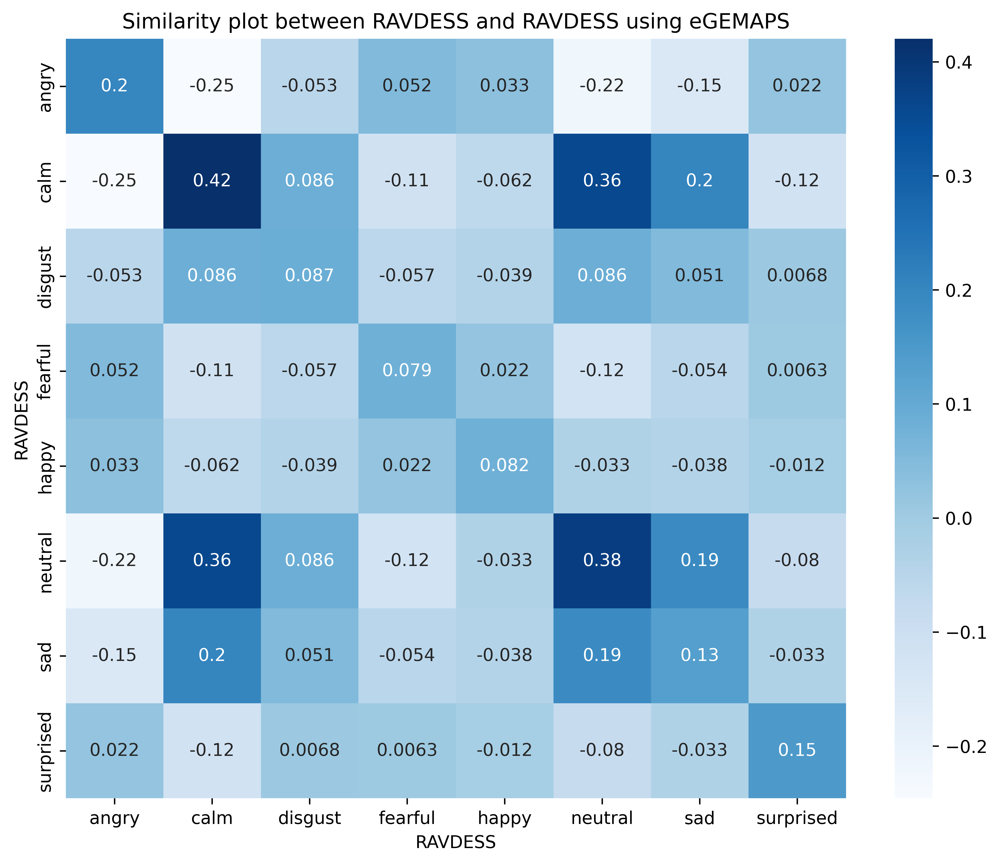

array([[ 0.20135151, -0.24583136, -0.05335427,  0.05202244,  0.03306228,
        -0.21815357, -0.14896028,  0.02155154],
       [-0.24583133,  0.42011788,  0.08582269, -0.11464548, -0.06227733,
         0.35953304,  0.20404147, -0.11576743],
       [-0.05335427,  0.08582269,  0.0872914 , -0.05729835, -0.038648  ,
         0.08596412,  0.05074604,  0.00675152],
       [ 0.05202245, -0.11464548, -0.05729835,  0.07946296,  0.02193867,
        -0.11943316, -0.05380749,  0.00628848],
       [ 0.03306227, -0.06227733, -0.03864799,  0.02193866,  0.08178564,
        -0.03334174, -0.03772837, -0.01182042],
       [-0.21815357,  0.35953307,  0.08596412, -0.11943316, -0.03334175,
         0.38225549,  0.18764645, -0.07969111],
       [-0.14896026,  0.20404145,  0.05074604, -0.05380749, -0.03772837,
         0.18764645,  0.13158594, -0.03295214],
       [ 0.02155154, -0.11576743,  0.00675152,  0.00628848, -0.01182042,
        -0.07969111, -0.03295214,  0.14786063]])

In [66]:
get_similarity_matrix(X_ravdess_norm, np.array(emotions), X_ravdess_norm, np.array(emotions), xlabel = "RAVDESS", ylabel="RAVDESS", similarity_measure="eGEMAPS", figsize=(10, 8))

In [93]:
get_similarity_matrix(X_hindi_norm, np.array(attitude), X_hindi_norm, np.array(attitude), xlabel = "Hindi Attitude", ylabel="Hindi Attitude", similarity_measure="eGEMAPS", figsize=(15,15))

array([[ 0.06250098, -0.01327776, -0.02464061, -0.0063749 , -0.02691426,
        -0.01121254, -0.00637213,  0.03982574,  0.00167247, -0.00144039,
        -0.02478409,  0.01183541, -0.01293722, -0.00276538,  0.00968635,
         0.01638018],
       [-0.01327776,  0.15823548,  0.11103527,  0.0367464 , -0.03193583,
        -0.08392243,  0.04671758,  0.13433011, -0.00213925, -0.03796812,
        -0.0341061 , -0.05366118, -0.05278192, -0.01628836, -0.05554477,
        -0.13043696],
       [-0.02464061,  0.11103528,  0.10716297,  0.02846179, -0.00546195,
        -0.06145261,  0.0404219 ,  0.07603445, -0.00580896, -0.02599866,
        -0.01022928, -0.04288813, -0.0329168 , -0.01606787, -0.04855873,
        -0.10441075],
       [-0.0063749 ,  0.0367464 ,  0.02846179,  0.05187647,  0.02903426,
        -0.04685304,  0.00844871, -0.02601364, -0.01505046,  0.01352324,
        -0.01423997,  0.03558253,  0.02125078, -0.07729998, -0.00822068,
         0.0284075 ],
       [-0.02691426, -0.03193583, -0

# Decision score based cosine similiarity heatmaps

In [103]:
ravdess_prob_score = grid_search.predict_proba(X_ravdess_norm)
hindi_prob_score = grid_search.predict_proba(X_hindi_norm)

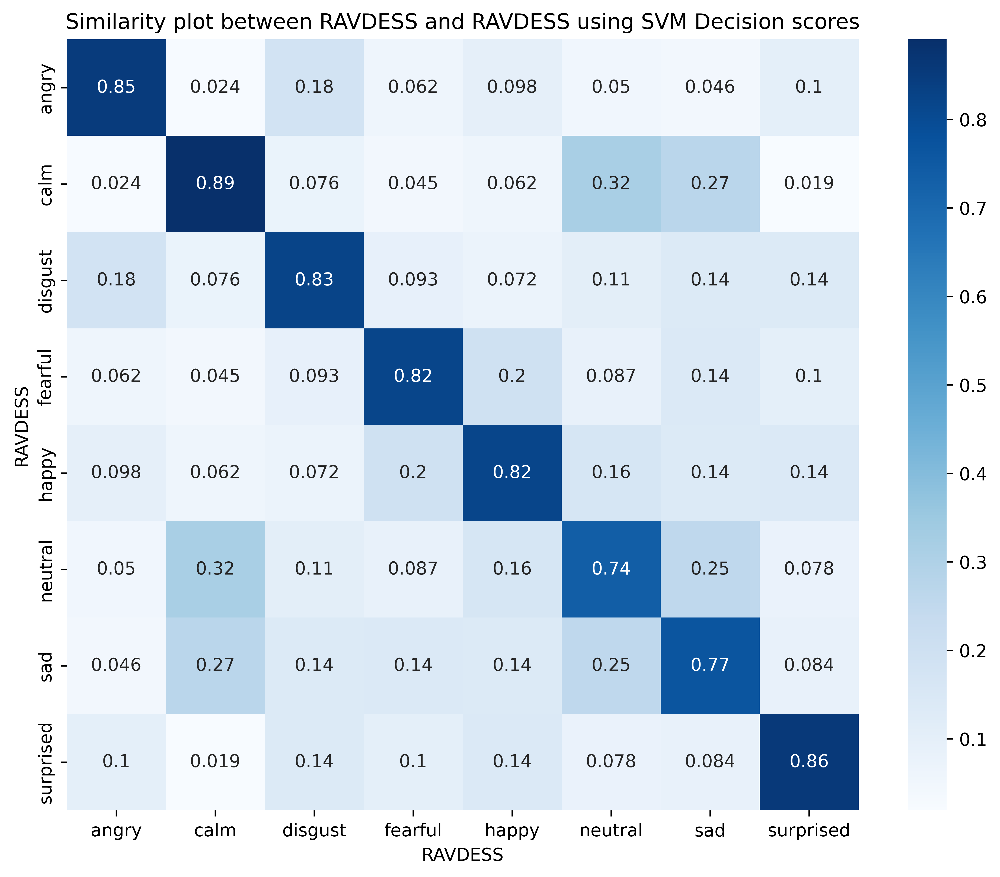

array([[0.849943  , 0.02360226, 0.1835212 , 0.06158168, 0.09762931,
        0.05042534, 0.04551766, 0.10208211],
       [0.02360226, 0.89041233, 0.0756316 , 0.04524537, 0.06177773,
        0.31668502, 0.26784204, 0.01919353],
       [0.1835212 , 0.0756316 , 0.82529766, 0.09276292, 0.07246787,
        0.10811242, 0.13634759, 0.13670402],
       [0.06158168, 0.04524537, 0.09276292, 0.81945968, 0.19954459,
        0.08660178, 0.14196511, 0.10099685],
       [0.09762931, 0.06177773, 0.07246787, 0.19954459, 0.81919815,
        0.16314243, 0.1380514 , 0.14413185],
       [0.05042534, 0.31668502, 0.10811242, 0.08660178, 0.16314243,
        0.73555837, 0.25490372, 0.07752185],
       [0.04551766, 0.26784204, 0.13634759, 0.14196511, 0.1380514 ,
        0.25490372, 0.76515546, 0.08441337],
       [0.10208211, 0.01919353, 0.13670402, 0.10099685, 0.14413185,
        0.07752185, 0.08441337, 0.85956728]])

In [104]:
get_similarity_matrix(ravdess_prob_score, np.array(emotions), ravdess_prob_score, np.array(emotions), xlabel = "RAVDESS", ylabel="RAVDESS", similarity_measure="SVM Decision scores", figsize=(10, 8))

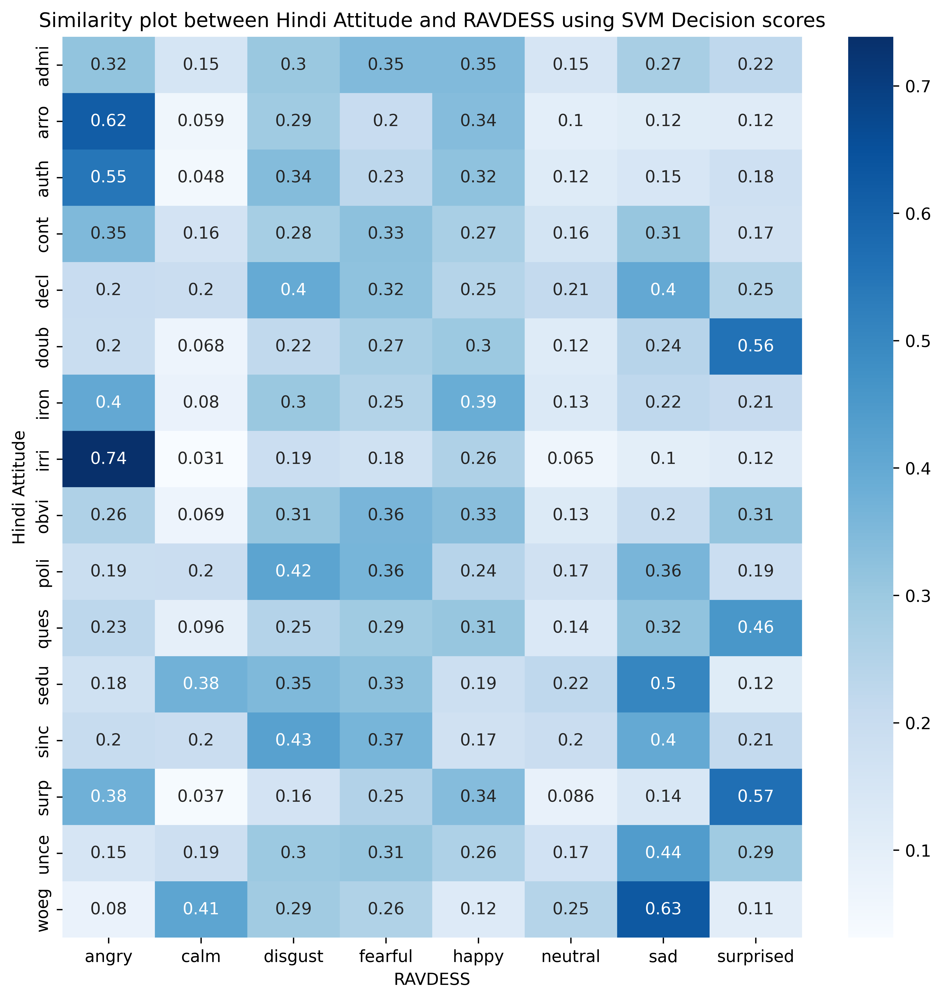

array([[0.31805488, 0.15473191, 0.3020846 , 0.34847436, 0.34729147,
        0.15216562, 0.27480122, 0.22406253],
       [0.61621461, 0.05897893, 0.29214802, 0.20018545, 0.33906311,
        0.10080156, 0.11671761, 0.11895273],
       [0.54748228, 0.0484148 , 0.3418097 , 0.22916231, 0.32157952,
        0.11978924, 0.14618254, 0.18007362],
       [0.34966695, 0.16126184, 0.27764828, 0.32563021, 0.27313036,
        0.16010141, 0.30844095, 0.17331381],
       [0.20007604, 0.19532802, 0.39736932, 0.32206295, 0.24619506,
        0.21171242, 0.40220094, 0.24994747],
       [0.19796878, 0.06801431, 0.22012555, 0.27356983, 0.30032887,
        0.12143627, 0.24328567, 0.55837159],
       [0.40295713, 0.08006157, 0.30401712, 0.25208809, 0.38784642,
        0.13089946, 0.22238624, 0.20748349],
       [0.73843483, 0.03128201, 0.19093443, 0.17622438, 0.2596836 ,
        0.0646852 , 0.10318773, 0.11731843],
       [0.25873056, 0.06894931, 0.30856654, 0.36073293, 0.3330396 ,
        0.12626506, 0.203742

In [115]:
get_similarity_matrix(ravdess_prob_score, np.array(emotions), hindi_prob_score, np.array(attitude), xlabel = "RAVDESS", ylabel="Hindi Attitude", similarity_measure="SVM Decision scores", figsize=(10,10))

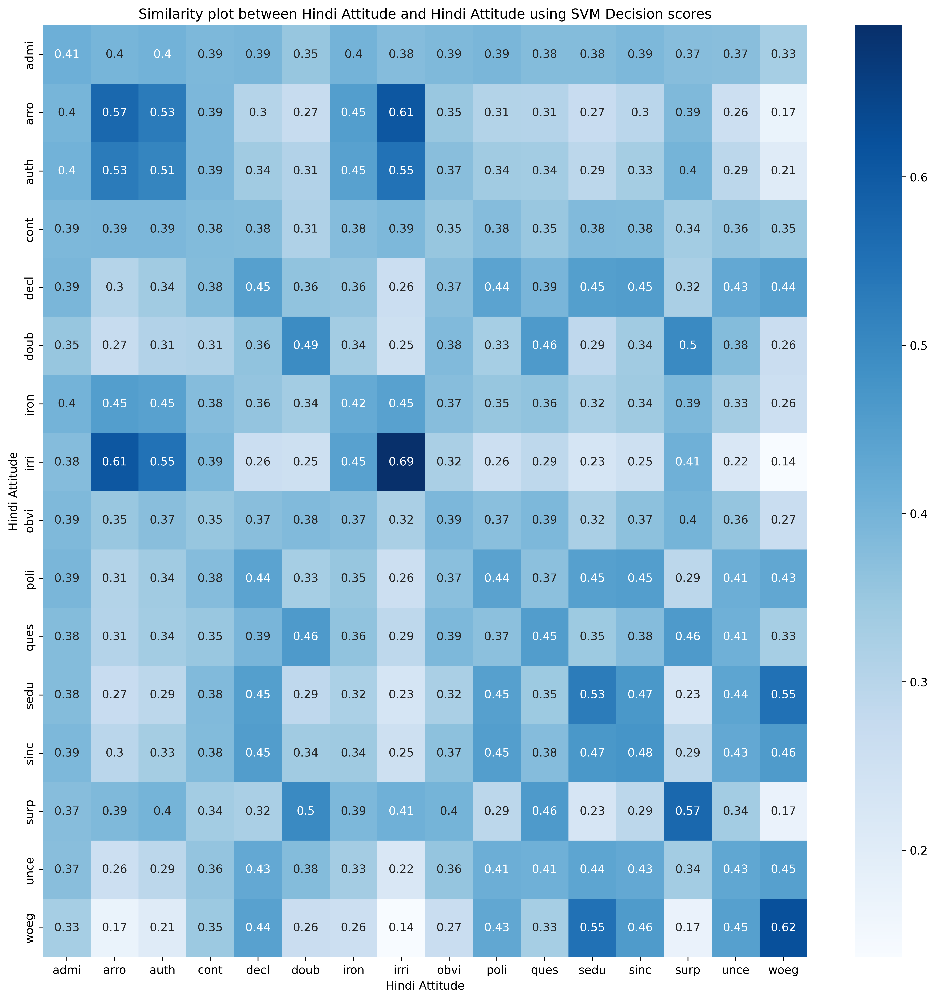

array([[0.40994575, 0.39665227, 0.40290073, 0.38854211, 0.39248604,
        0.35352858, 0.40029452, 0.37678012, 0.38629321, 0.39260324,
        0.37975592, 0.37971402, 0.38866763, 0.37458868, 0.37285479,
        0.33076896],
       [0.39665227, 0.5709359 , 0.53101279, 0.39003243, 0.3040629 ,
        0.27177041, 0.45346887, 0.60624551, 0.35229389, 0.30798374,
        0.30540588, 0.27003458, 0.29510527, 0.38716182, 0.25894992,
        0.17254972],
       [0.40290073, 0.53101279, 0.50923293, 0.39119645, 0.3381546 ,
        0.30982995, 0.44549738, 0.54910737, 0.37233837, 0.33903681,
        0.33688622, 0.29384344, 0.33212223, 0.39829775, 0.29398572,
        0.20529621],
       [0.38854211, 0.39003243, 0.39119645, 0.38242208, 0.37906487,
        0.31473629, 0.37855973, 0.38785482, 0.35348629, 0.37742264,
        0.35092944, 0.38451357, 0.38245292, 0.33736758, 0.35842859,
        0.34836602],
       [0.39248604, 0.3040629 , 0.3381546 , 0.37906487, 0.44824066,
        0.36206385, 0.35740761, 

In [116]:
get_similarity_matrix(hindi_prob_score, np.array(attitude), hindi_prob_score, np.array(attitude), xlabel = "Hindi Attitude", ylabel="Hindi Attitude", similarity_measure="SVM Decision scores", figsize=(15,15))

# SAVEE clustering based of RAVDESS SVM Model

In [135]:
X_savee,speaker_id_savee, file_name_savee, _ = utils.load_wav_features("C:\\Users\\HP\\Downloads\\AudioDataSAVEE\\AudioData\\")

In [143]:
emotion_savee = utils.process_savee(file_name_savee)

In [145]:
scaler = utils.StandardScaleNormalizer()
X_savee_norm = scaler.fit_transform(X_savee, speaker_id_savee)

In [148]:
savee_data_loader = utils.CustomDataLoader(X_savee_norm, speaker_id_savee, emotion_savee, file_name_savee)

In [149]:
savee_prob_score = grid_search.predict_proba(savee_data_loader.data)

In [161]:
labels_ravdess = np.sort(['neutral', 'calm', 'happy', 'sad', 'angry', 'fearful', 'disgust', 'surprised'])
predictions = [labels_ravdess[i] for i in np.argmax(savee_prob_score, axis=1)]

In [163]:
df_labels_new = pd.DataFrame()
df_labels_new["SAVEE Labels"] = emotion_savee
df_labels_new["RAVDESS Labels"] = predictions
df_labels_new_comp = pd.crosstab(df_labels_new["SAVEE Labels"], df_labels_new["RAVDESS Labels"])

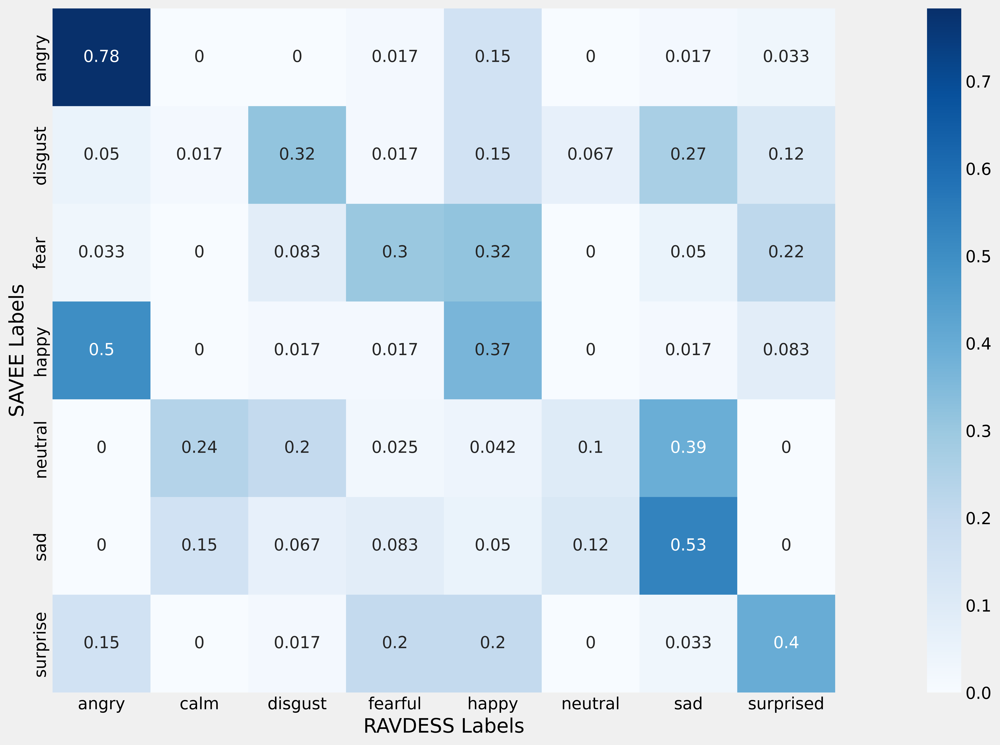

In [164]:
plt.rcParams['figure.dpi'] = 600
plt.figure(figsize=(25,10))
sns.heatmap(df_labels_new_comp/df_labels_new_comp.sum(axis=1)[:, np.newaxis], cmap="Blues",square= True, annot=True)
plt.savefig("D:\\Speech Emotion Recognition\\Speech-Emotion-Detection\\figures\\final_grouping_savee_to_ravdess.png")

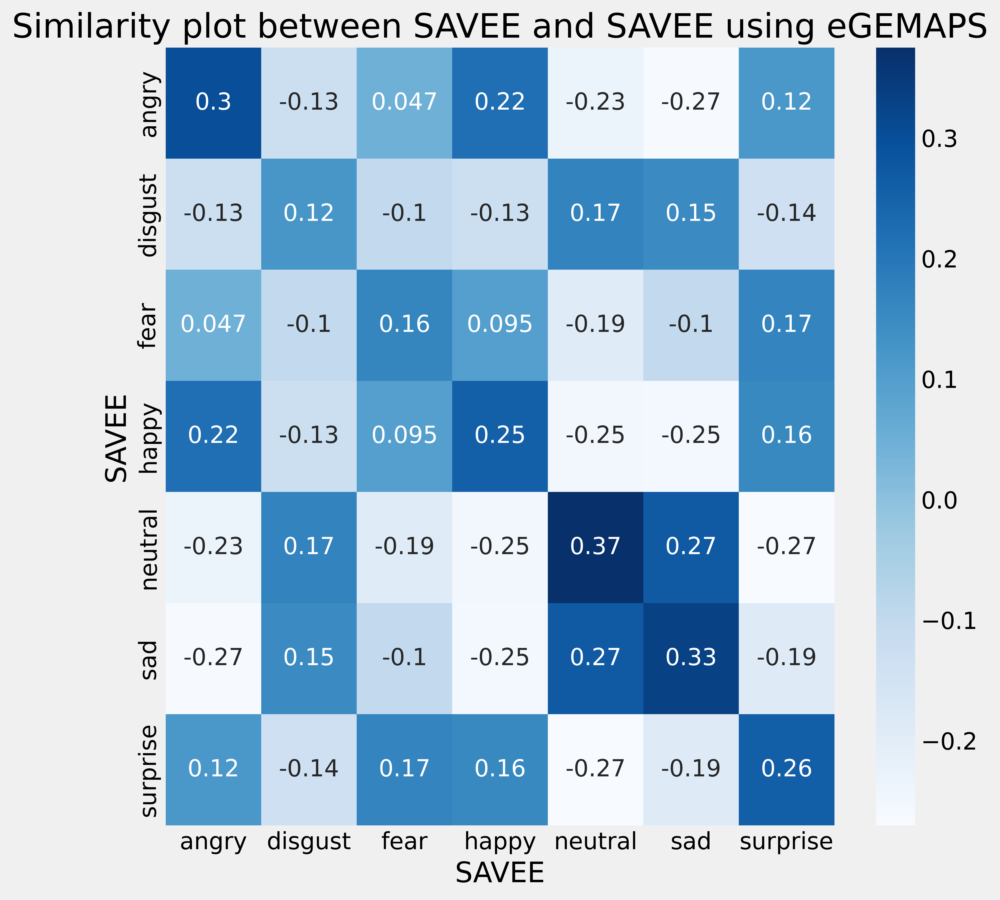

array([[ 0.30112183, -0.12733774,  0.04700123,  0.21812533, -0.23496912,
        -0.26644024,  0.11659724],
       [-0.12733774,  0.12141445, -0.09968617, -0.12679709,  0.17026103,
         0.14805207, -0.13575284],
       [ 0.04700124, -0.09968617,  0.16457038,  0.09530161, -0.1907434 ,
        -0.10144568,  0.16704728],
       [ 0.21812534, -0.12679709,  0.09530162,  0.25396067, -0.25235566,
        -0.2528829 ,  0.15533166],
       [-0.23496914,  0.17026103, -0.1907434 , -0.25235566,  0.37487787,
         0.26916057, -0.27043474],
       [-0.26644027,  0.14805207, -0.10144567, -0.2528829 ,  0.26916057,
         0.33118463, -0.18870677],
       [ 0.11659724, -0.13575284,  0.16704729,  0.15533166, -0.27043474,
        -0.18870679,  0.25870109]])

In [155]:
get_similarity_matrix(X_savee_norm, np.array(emotion_savee), X_savee_norm, np.array(emotion_savee), xlabel = "SAVEE", ylabel="SAVEE", similarity_measure="eGEMAPS", figsize=(8, 8))

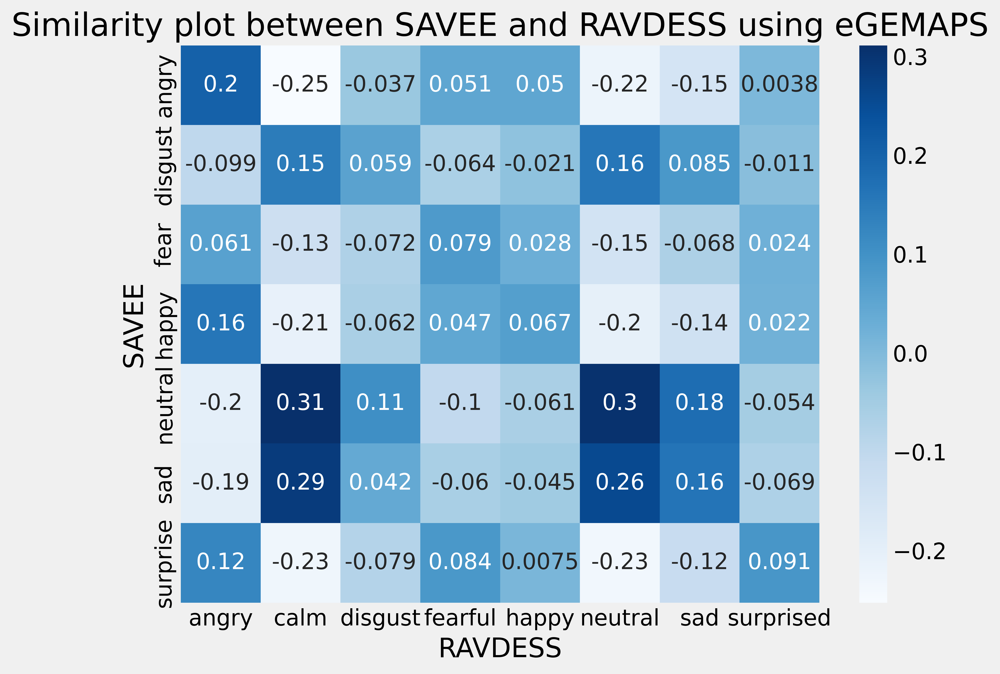

array([[ 0.2035801 , -0.25274375, -0.0365341 ,  0.05062674,  0.04967025,
        -0.2202958 , -0.15296282,  0.00380163],
       [-0.09889694,  0.14686611,  0.05895812, -0.06431793, -0.02061231,
         0.15768027,  0.08524302, -0.011419  ],
       [ 0.06112619, -0.1300742 , -0.07215564,  0.07946518,  0.02803127,
        -0.14684056, -0.06760539,  0.02398633],
       [ 0.15699896, -0.21049124, -0.06184138,  0.04725754,  0.06658946,
        -0.20426323, -0.13788746,  0.02193633],
       [-0.19828318,  0.3109968 ,  0.10609065, -0.10429649, -0.06128116,
         0.30446938,  0.17774555, -0.05448152],
       [-0.19414125,  0.28511298,  0.0422907 , -0.0597527 , -0.04462643,
         0.25688252,  0.16343655, -0.06872726],
       [ 0.12392245, -0.22902955, -0.07903936,  0.08435704,  0.00748962,
        -0.23484381, -0.11727917,  0.09070761]])

In [160]:
get_similarity_matrix(X_ravdess_norm, np.array(emotions), X_savee_norm, np.array(emotion_savee), xlabel = "RAVDESS", ylabel="SAVEE", similarity_measure="eGEMAPS", figsize=(8,6))

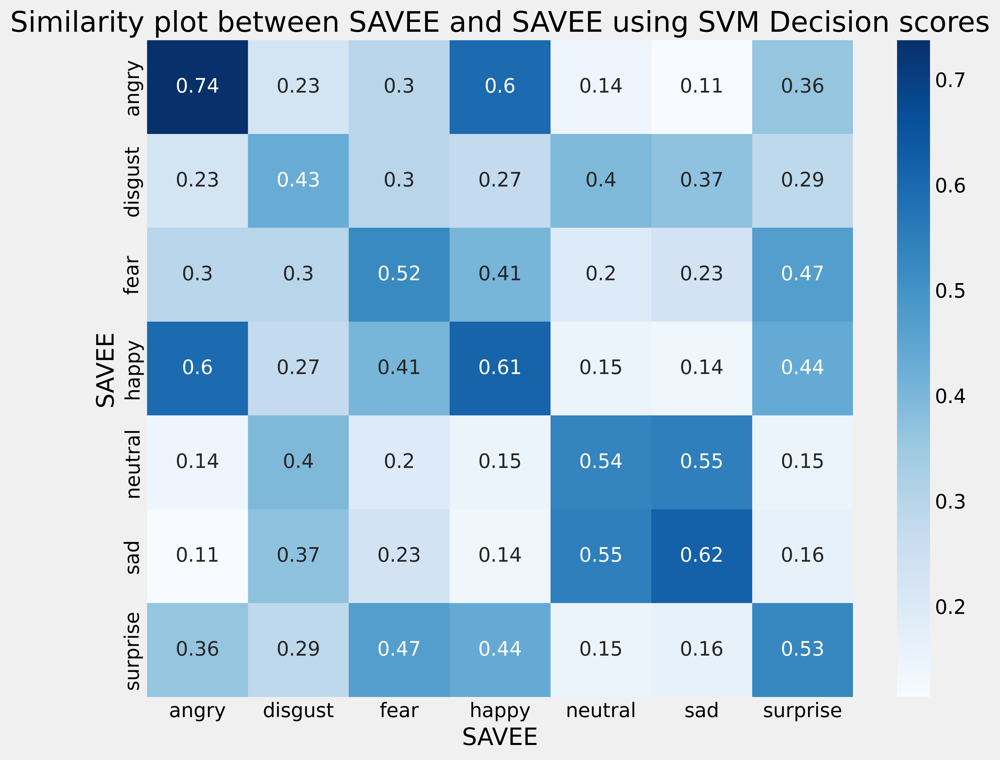

array([[0.73718718, 0.22652832, 0.29549985, 0.59746791, 0.14093899,
        0.11382389, 0.36158501],
       [0.22652832, 0.43220417, 0.29816127, 0.27330999, 0.39532259,
        0.37165698, 0.2853345 ],
       [0.29549985, 0.29816127, 0.52111557, 0.40674994, 0.19655045,
        0.23042003, 0.46936751],
       [0.59746791, 0.27330999, 0.40674994, 0.61256226, 0.15173131,
        0.14001622, 0.43567471],
       [0.14093899, 0.39532259, 0.19655045, 0.15173131, 0.53596906,
        0.54743902, 0.14928032],
       [0.11382389, 0.37165698, 0.23042003, 0.14001622, 0.54743902,
        0.61902429, 0.16255477],
       [0.36158501, 0.2853345 , 0.46936751, 0.43567471, 0.14928032,
        0.16255477, 0.53048028]])

In [151]:
get_similarity_matrix(savee_prob_score, np.array(emotion_savee), savee_prob_score, np.array(emotion_savee), xlabel = "SAVEE", ylabel="SAVEE", similarity_measure="SVM Decision scores", figsize=(10, 8))

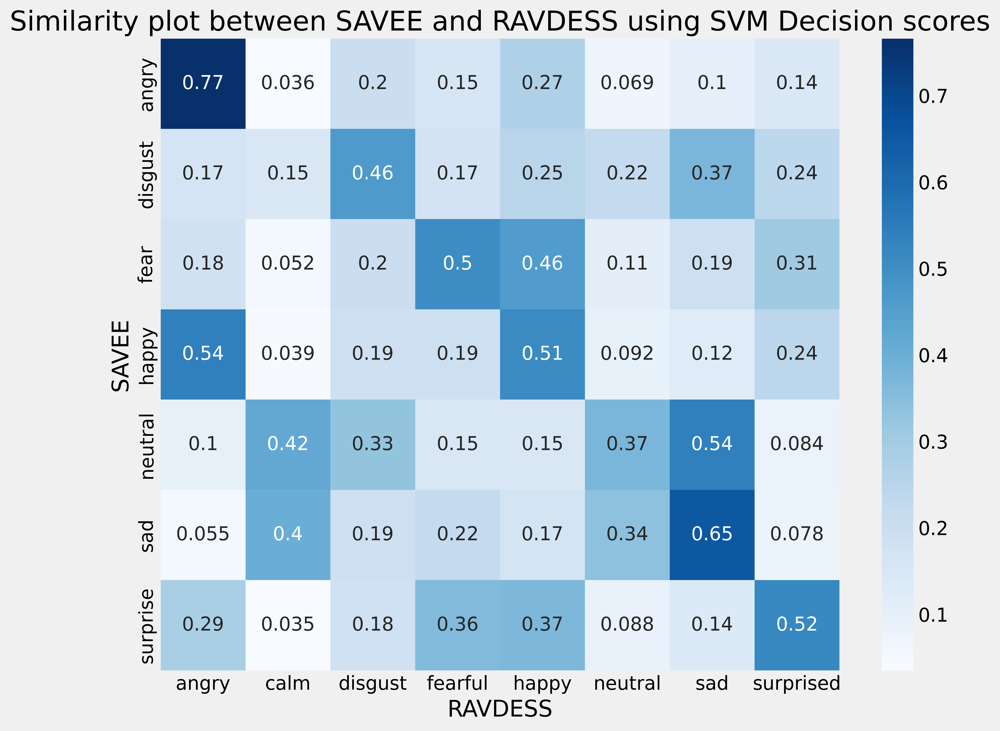

array([[0.76579556, 0.036113  , 0.20020279, 0.15295472, 0.27071998,
        0.06895   , 0.10084463, 0.14331528],
       [0.16635219, 0.14914842, 0.46436447, 0.16990252, 0.25098083,
        0.22321339, 0.37251906, 0.23907921],
       [0.17949335, 0.05199598, 0.19902889, 0.50396195, 0.45781078,
        0.10685733, 0.18980159, 0.30675012],
       [0.54253641, 0.03913935, 0.1872462 , 0.19103587, 0.51031566,
        0.09217025, 0.12233718, 0.24123095],
       [0.09959652, 0.41870488, 0.33159942, 0.14740251, 0.14729054,
        0.37403934, 0.54081574, 0.08408083],
       [0.05503028, 0.40289339, 0.19481612, 0.22167622, 0.16694407,
        0.33808837, 0.65186794, 0.07782635],
       [0.28515511, 0.03506592, 0.18365485, 0.36299296, 0.36820024,
        0.08794222, 0.1365426 , 0.51869867]])

In [154]:
get_similarity_matrix(ravdess_prob_score, np.array(emotions), savee_prob_score, np.array(emotion_savee),  ylabel = "SAVEE", xlabel="RAVDESS", similarity_measure="SVM Decision scores", figsize=(10,8))

# K - Nearest Neighbours

In [129]:
# kmeans_kwargs = {"init": "random","n_init": 10,"max_iter": 300,"random_state": 42,}

# sse = []
# silhouette_coefficients = []
# for k in range(2, 17):
#     kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
#     kmeans.fit(X_hindi_norm)
#     sse.append(kmeans.inertia_)
#     score = silhouette_score(hindi_prob_score, kmeans.labels_)
#     silhouette_coefficients.append(score)

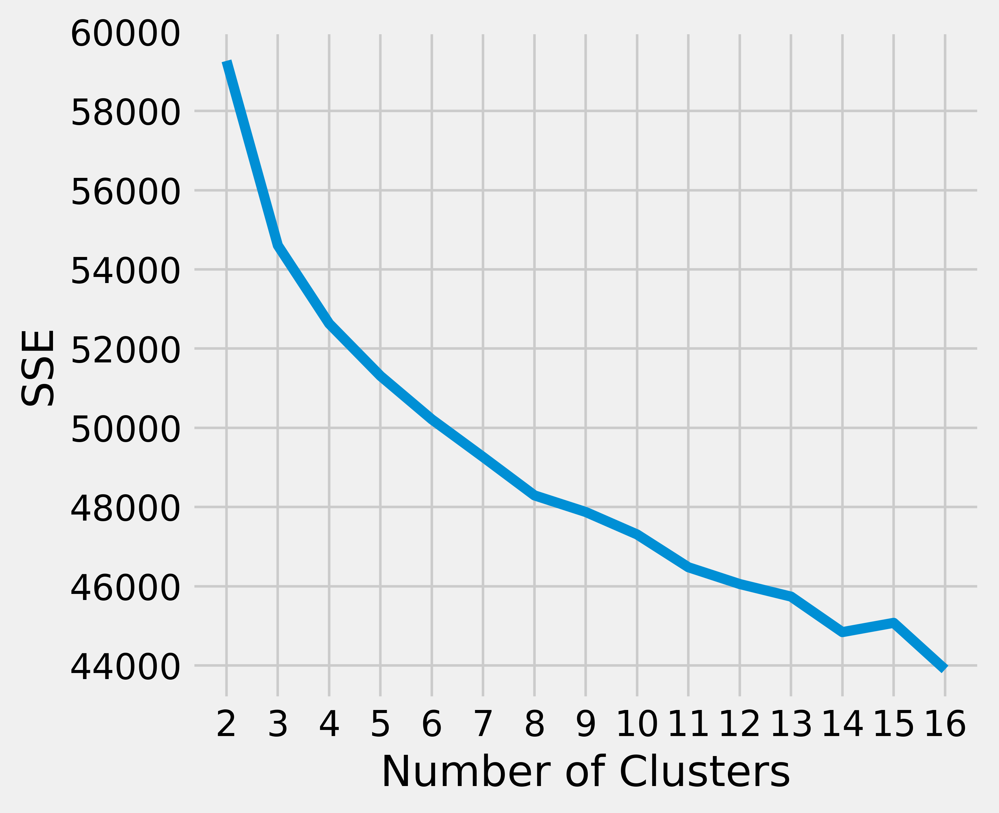

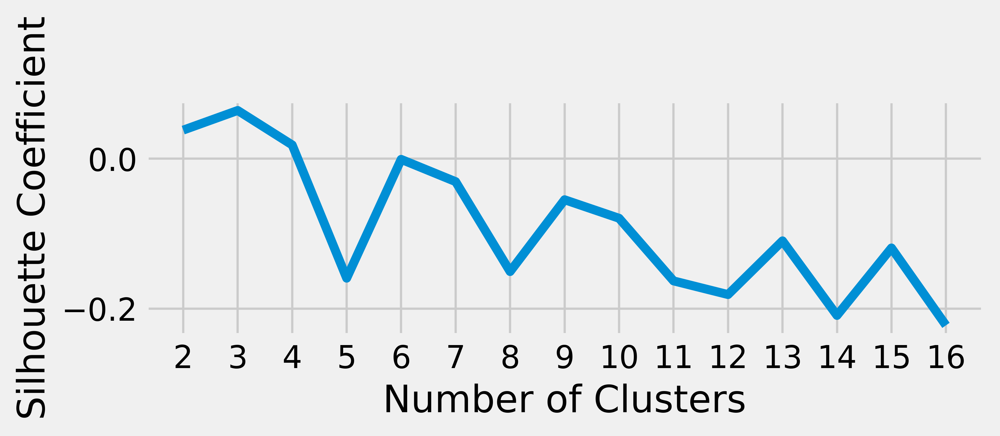

In [134]:
# plt.figure(figsize=(5, 10))
# plt.subplot(211)
# #plt.style.use("fivethirtyeight")
# plt.plot(range(2, 17), sse)
# plt.xticks(range(2, 17))
# plt.xlabel("Number of Clusters")
# plt.ylabel("SSE")
# plt.show()
# plt.subplot(212)
# #plt.style.use("fivethirtyeight")
# plt.plot(range(2, 17), silhouette_coefficients)
# plt.xticks(range(2, 17))
# plt.xlabel("Number of Clusters")
# plt.ylabel("Silhouette Coefficient")
# plt.show()

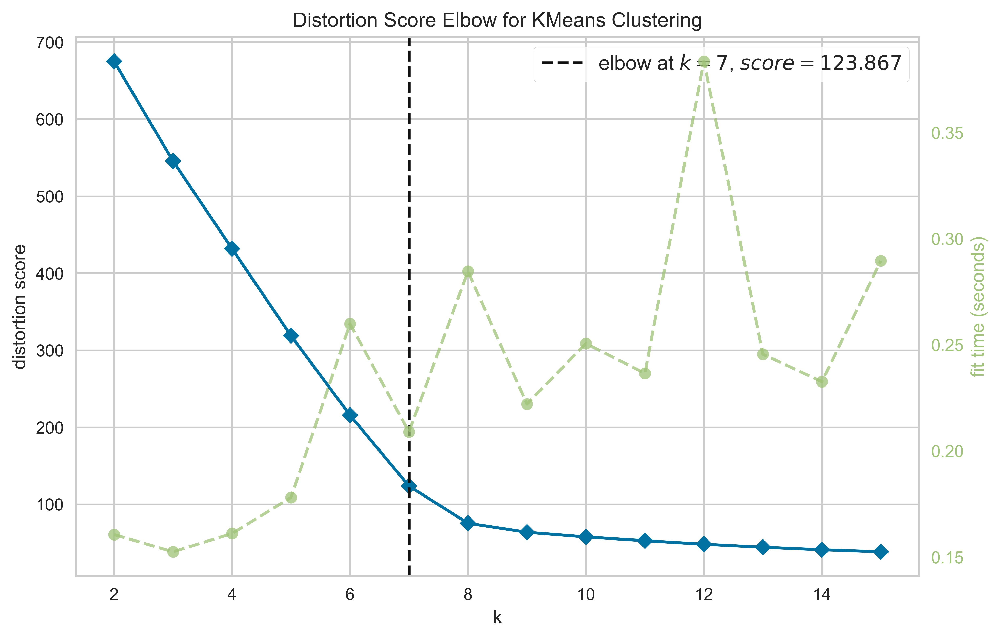

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [180]:
from yellowbrick.cluster import KElbowVisualizer
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,16))
 
visualizer.fit(ravdess_prob_score)        # Fit the data to the visualizer
visualizer.show()

In [183]:
from yellowbrick.cluster import SilhouetteVisualizer
fig, ax = plt.subplots(4, 2, figsize=(15,16))
for i in [2, 3, 4, 5, 6, 7, 8, 9]:
    '''
    Create KMeans instance for different number of clusters
    '''
    km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=42)
    q, mod = divmod(i, 2)
    '''
    Create SilhouetteVisualizer instance with KMeans instance
    Fit the visualizer
    '''
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(hindi_prob_score) 

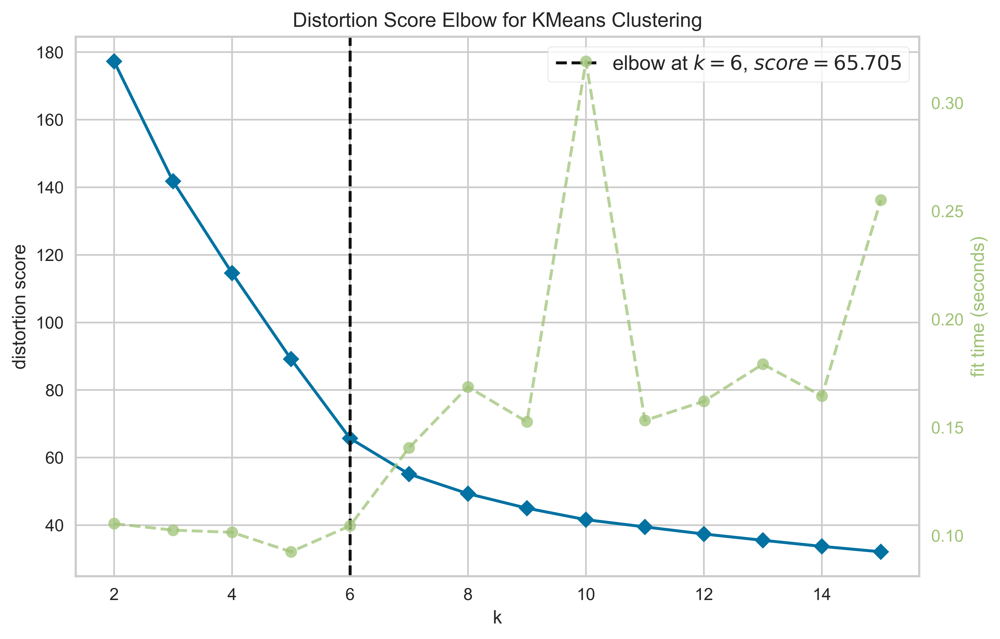

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [189]:
from yellowbrick.cluster import KElbowVisualizer
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,16))
 
visualizer.fit(hindi_prob_score)        # Fit the data to the visualizer
visualizer.show()

In [192]:
fig, ax = plt.subplots(5, 2, figsize=(15,16))
for i in [2, 3, 4, 5, 6, 7, 8, 9, 10, 11]:
    '''
    Create KMeans instance for different number of clusters
    '''
    km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=42)
    q, mod = divmod(i, 2)
    '''
    Create SilhouetteVisualizer instance with KMeans instance
    Fit the visualizer
    '''
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(hindi_prob_score) 

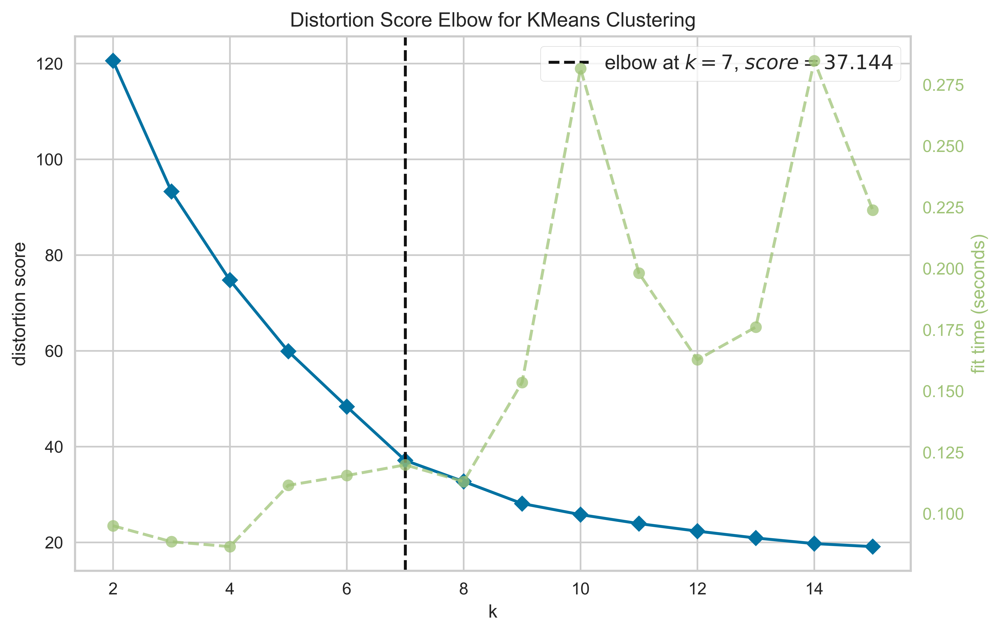

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [193]:
from yellowbrick.cluster import KElbowVisualizer
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,16))
 
visualizer.fit(savee_prob_score)        # Fit the data to the visualizer
visualizer.show()

In [194]:
fig, ax = plt.subplots(4, 2, figsize=(15,16))
for i in [2, 3, 4, 5, 6, 7, 8, 9]:
    '''
    Create KMeans instance for different number of clusters
    '''
    km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=42)
    q, mod = divmod(i, 2)
    '''
    Create SilhouetteVisualizer instance with KMeans instance
    Fit the visualizer
    '''
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(savee_prob_score) 

# The IIT KGP datatset

In [4]:
path_to_kgp_data = "C:\\Users\\HP\\Downloads\\IITKGP_SEHSC_clean\\"

In [178]:
filelist=[]
for path, subdirs, files in os.walk(path_to_kgp_data):
    for file in files:
        if (file.endswith('.wav') or file.endswith('.WAV')):
            print(file)
            filelist.append(os.path.join(path, file))

1.1.anger-01.wav
1.1.anger-02.wav
1.1.anger-03.wav
1.1.anger-04.wav
1.1.anger-05.wav
1.1.anger-06.wav
1.1.anger-07.wav
1.1.anger-08.wav
1.1.anger-09.wav
1.1.anger-10.wav
1.1.anger-11.wav
1.1.anger-12.wav
1.1.anger-13.wav
1.1.anger-14.wav
1.1.anger-15.wav
1.1.disgust-01.wav
1.1.disgust-02.wav
1.1.disgust-03.wav
1.1.disgust-04.wav
1.1.disgust-05.wav
1.1.disgust-06.wav
1.1.disgust-07.wav
1.1.disgust-08.wav
1.1.disgust-09.wav
1.1.disgust-10.wav
1.1.disgust-11.wav
1.1.disgust-12.wav
1.1.disgust-13.wav
1.1.disgust-14.wav
1.1.disgust-15.wav
1.1.fear-01.wav
1.1.fear-02.wav
1.1.fear-03.wav
1.1.fear-04.wav
1.1.fear-05.wav
1.1.fear-06.wav
1.1.fear-07.wav
1.1.fear-08.wav
1.1.fear-09.wav
1.1.fear-10.wav
1.1.fear-11.wav
1.1.fear-12.wav
1.1.fear-13.wav
1.1.fear-14.wav
1.1.fear-15.wav
1.1.happy-01.wav
1.1.happy-02.wav
1.1.happy-03.wav
1.1.happy-04.wav
1.1.happy-05.wav
1.1.happy-06.wav
1.1.happy-07.wav
1.1.happy-08.wav
1.1.happy-09.wav
1.1.happy-10.wav
1.1.happy-11.wav
1.1.happy-12.wav
1.1.happy-13.wav

In [65]:
emotions_list_kgp = ['anger', "fear", "neutral", "sarcastic", 'disgust', 'happy', 'sadness', 'surprise']
emotion_dict = {'anger': 0, "fear": 1, "neutral": 2, "sarcastic": 3, 'disgust': 4, 'happy': 5, 'sadness': 6, 'surprise': 7}

In [60]:
freq = [0]*10 # store the frequencies of the speakers and  their samples

emotion_freq = {}
for i in emotions_list_kgp:
    emotion_freq[i] = [0]*10 # store in each key the entire list of frequencies for every speaker that we have and update accordingly
    
for i in filelist:
    #print(int(i.split('\\')[-1].split('.')[0])-1)
    freq[int(i.split('\\')[-1].split('.')[0])-1] += 1
    emotion_freq[i.split('\\')[-2]][int(i.split('\\')[-1].split('.')[0])-1] += 1
freq

[996, 975, 1046, 1122, 1094, 51, 0, 0, 0, 1054]

Text(0.5, 1.0, 'Number of samples per speaker in the IITKGP-SEHSC dataset')

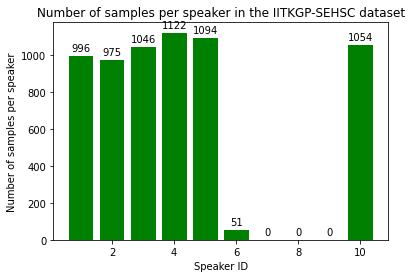

In [74]:
plt.bar(range(1,11), freq, color = 'g')
plt.bar_label(plt.bar(range(1,11), freq, color = 'g'), padding=3);
plt.xlabel("Speaker ID")
plt.ylabel("Number of samples per speaker")
plt.title("Number of samples per speaker in the IITKGP-SEHSC dataset")

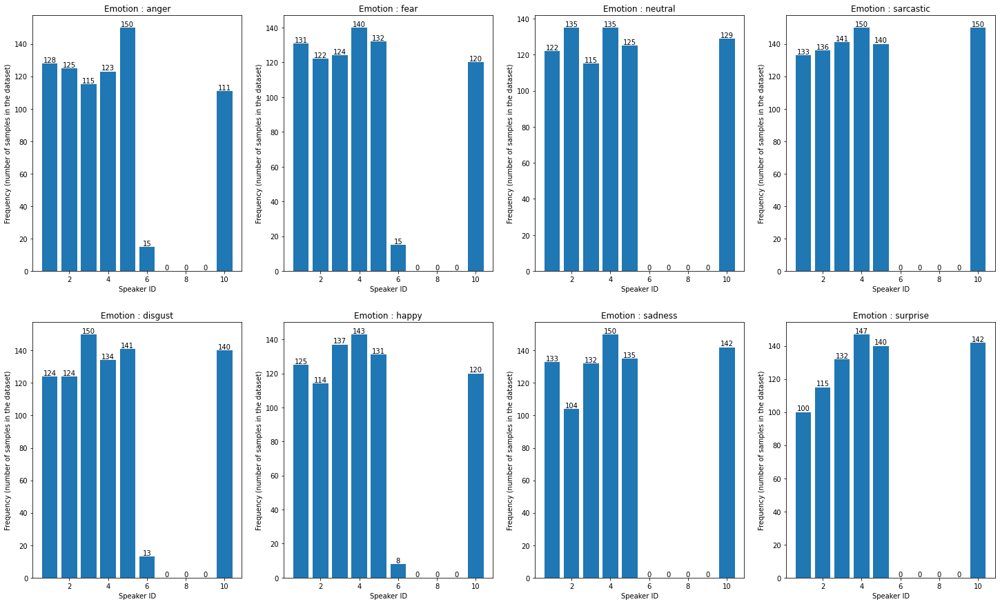

In [70]:
fig, ax = plt.subplots(2, 4, figsize=(25,15))
for i in emotions_list_kgp:
    q, mod = divmod(emotion_dict[i], 4)
    ax[q][mod].bar(range(1,11), emotion_freq[i])
    ax[q][mod].bar_label(ax[q][mod].containers[0])
    ax[q][mod].set_title("Emotion : {}".format(i))
    ax[q][mod].set_xlabel('Speaker ID')
    ax[q][mod].set_ylabel('Frequency (number of samples in the dataset)')

In [5]:
X_kgp_data = utils.load_wav_features(path_to_kgp_data)

In [6]:
speaker_kgp =[]
emotion_kgp = []
utt_kgp = []
for i in X_kgp_data[2]:
    speak_inst_ = i.split('.')[0]
    if i.split('.')[2].split('-')[0] in ['sarcasic', '1nger', 'ange','sarcastuic']:
        print(i)
    speaker_kgp.append(speak_inst_)
    emotion_kgp.append(i.split('.')[2].split('-')[0])
    utt_kgp.append(i.split('.')[2].split('-')[1])

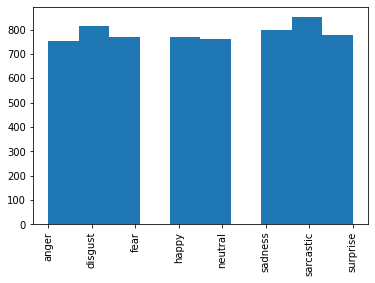

In [7]:
plt.hist(emotion_kgp);
plt.xticks(rotation='vertical');

In [8]:
scaler = utils.StandardScaleNormalizer()
X_kgp_norm = scaler.fit_transform(X_kgp_data[0], speaker_kgp)

In [9]:
# Define the mapping of speaker IDs to folds
# 6 speakers so we have 6 folds
fold_mapping = {'1' : 1, '2' : 2, '3' : 3, '4' : 4, '5' : 5, '10' : 6}

In [10]:
kgp_folds = [f"Fold {fold_mapping.get(x)}" for x in speaker_kgp]

In [19]:
from sklearn.model_selection import LeaveOneGroupOut
from sklearn.model_selection import GridSearchCV
logo = LeaveOneGroupOut()
fold_generated = logo.split(X_kgp_norm, emotion_kgp, kgp_folds)

# param_grid = {'C': [ 1, 10, 100, 1000,10000], 
#                 'gamma': [5,1,0.1,0.01,0.001,0.0001],
#                 'kernel': ['rbf']}

param_grid = {'C' : [1,10], 'gamma':[0.001,0.0001], 'kernel':['rbf']}

ml = svm.SVC(probability = True) 
grid = GridSearchCV(ml, param_grid, refit = True, verbose = 1,cv=fold_generated)
    
    # fitting the model for grid search
grid_search=grid.fit(X_kgp_norm, emotion_kgp)

Fitting 6 folds for each of 4 candidates, totalling 24 fits


In [18]:
# Print the best hyperparameters found
print("Tuned SVM Parameters: {}".format(grid_search.best_params_))
# Print the evaluation score of the best hyperparameters
print("Best SVM model average cross-validation accuracy: {:.2f}%".format(grid_search.best_score_*100))

Tuned SVM Parameters: {'C': 10, 'gamma': 0.001, 'kernel': 'rbf'}
Best SVM model average cross-validation accuracy: 51.89%


In [26]:
prob_sum = grid_search.predict_proba(X_ravdess_norm)

In [29]:
labels_kgp = sorted(['anger', "fear", "neutral", "sarcastic", 'disgust', 'happy', 'sadness', 'surprise'])
predictions = [labels_kgp[i] for i in np.argmax(prob_sum, axis=1)]

In [39]:
df_labels_new = pd.DataFrame()
df_labels_new["KGP labels (Predicted)"] = predictions
df_labels_new["RAVDESS Labels (True)"] = emotions
df_labels_new_comp = pd.crosstab(df_labels_new["RAVDESS Labels (True)"], df_labels_new["KGP labels (Predicted)"])

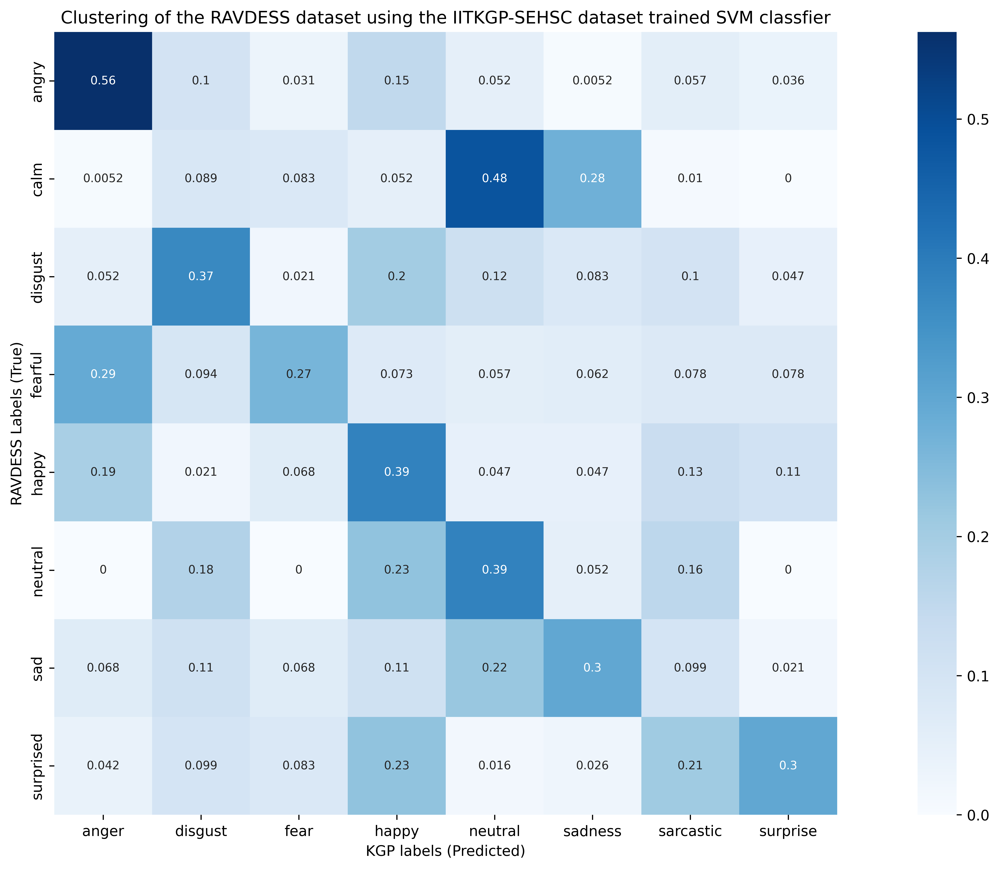

In [40]:
plt.rcParams['figure.dpi'] = 600
plt.figure(figsize=(20,10))
sns.heatmap(df_labels_new_comp/df_labels_new_comp.sum(axis=1)[:, np.newaxis], cmap="Blues",square= True, annot=True, annot_kws={'size': 8})
plt.title("Clustering of the RAVDESS dataset using the IITKGP-SEHSC dataset trained SVM classfier")
plt.savefig("D:\\Speech Emotion Recognition\\Speech-Emotion-Detection\\figures\\grouping_ravdess_using_kgp.png")

In [44]:
prob_sum = grid_search.predict_proba(X_hindi_norm)

In [45]:
labels_kgp = sorted(['anger', "fear", "neutral", "sarcastic", 'disgust', 'happy', 'sadness', 'surprise'])
predictions = [labels_kgp[i] for i in np.argmax(prob_sum, axis=1)]

In [47]:
df_labels_new = pd.DataFrame()
df_labels_new["KGP labels (Predicted)"] = predictions
df_labels_new["Hindi attitude Labels (True)"] = attitude
df_labels_new_comp = pd.crosstab(df_labels_new["Hindi attitude Labels (True)"], df_labels_new["KGP labels (Predicted)"])

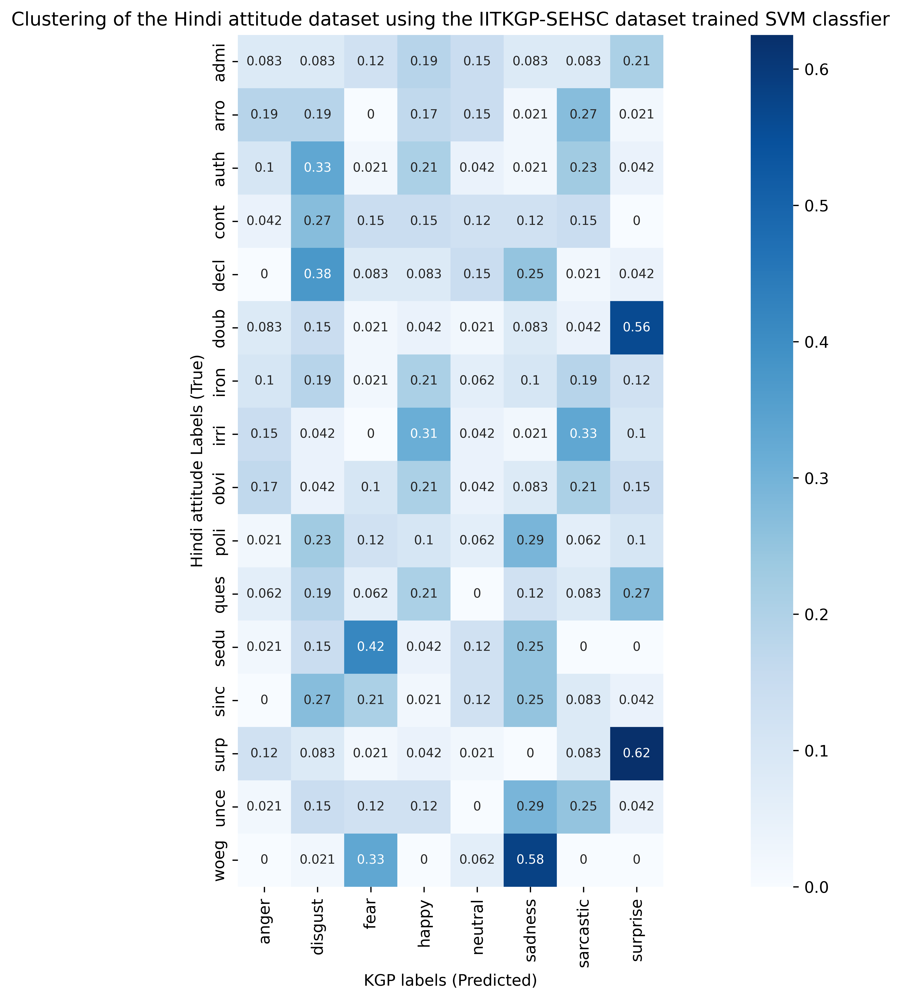

In [48]:
plt.rcParams['figure.dpi'] = 600
plt.figure(figsize=(20,10))
sns.heatmap(df_labels_new_comp/df_labels_new_comp.sum(axis=1)[:, np.newaxis], cmap="Blues",square= True, annot=True, annot_kws={'size': 8})
plt.title("Clustering of the Hindi attitude dataset using the IITKGP-SEHSC dataset trained SVM classfier")
plt.savefig("D:\\Speech Emotion Recognition\\Speech-Emotion-Detection\\figures\\grouping_hindi_attitude_using_kgp.png")

## Cosine similarity between datasets(eGEMAPS data)

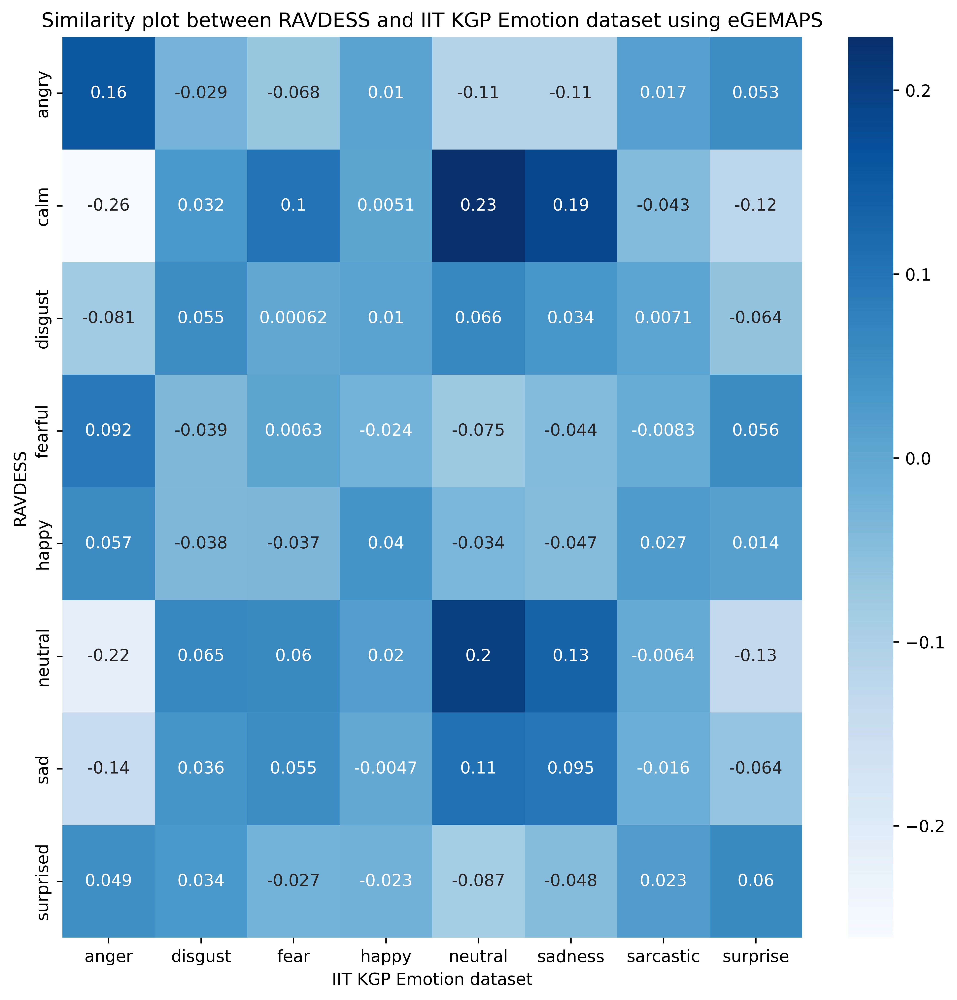

array([[ 0.15787561, -0.02923414, -0.06822031,  0.01047443, -0.11225452,
        -0.11298601,  0.01729159,  0.05309644],
       [-0.26081926,  0.03197797,  0.10390565,  0.00505517,  0.2289568 ,
         0.18699919, -0.0427727 , -0.12186632],
       [-0.08127728,  0.05453266,  0.00061992,  0.01019648,  0.06588222,
         0.03437918,  0.00705794, -0.06354921],
       [ 0.09166709, -0.03910254,  0.00631544, -0.02367215, -0.07495303,
        -0.04397495, -0.00828531,  0.05550225],
       [ 0.05747113, -0.03770002, -0.03667145,  0.03995251, -0.0341429 ,
        -0.04656617,  0.02669502,  0.01445003],
       [-0.21538557,  0.06508956,  0.05965683,  0.0196349 ,  0.19836432,
         0.13228773, -0.00643681, -0.13273416],
       [-0.136572  ,  0.03615963,  0.05481121, -0.00468259,  0.10517438,
         0.09510725, -0.01605563, -0.0644786 ],
       [ 0.04938681,  0.03356908, -0.02672239, -0.02339906, -0.0868944 ,
        -0.04828715,  0.0233961 ,  0.06007688]])

In [65]:
get_similarity_matrix(X_kgp_norm, np.array(emotion_kgp), X_ravdess_norm, np.array(emotions), xlabel="IIT KGP Emotion dataset", ylabel = "RAVDESS",  similarity_measure="eGEMAPS", figsize=(10,10))

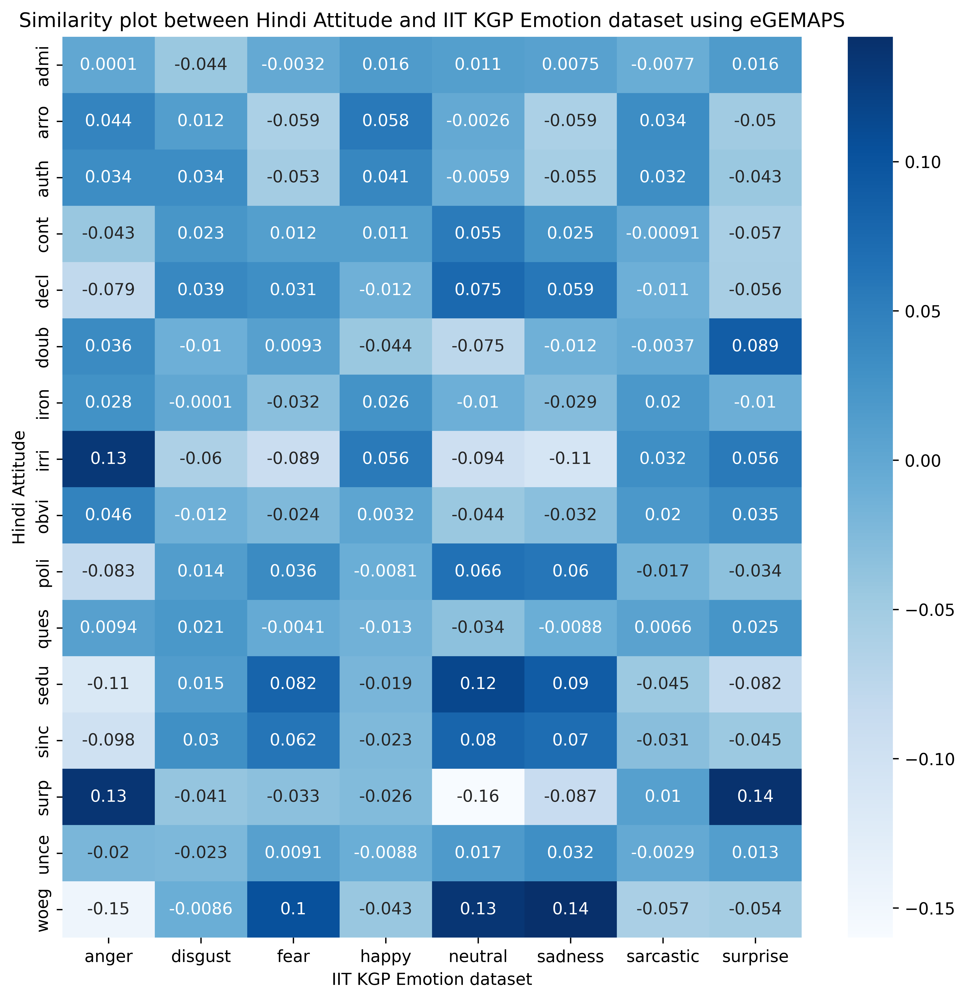

array([[ 1.00530633e-04, -4.42595966e-02, -3.18222889e-03,
         1.63218975e-02,  1.14698103e-02,  7.53125967e-03,
        -7.72515079e-03,  1.57092754e-02],
       [ 4.44142371e-02,  1.23841576e-02, -5.89216389e-02,
         5.79837933e-02, -2.64166947e-03, -5.87226264e-02,
         3.41332182e-02, -4.98674102e-02],
       [ 3.38316821e-02,  3.43552232e-02, -5.26374765e-02,
         4.07441631e-02, -5.86746866e-03, -5.46490029e-02,
         3.24706808e-02, -4.33058403e-02],
       [-4.26133797e-02,  2.28686500e-02,  1.20041855e-02,
         1.14434566e-02,  5.48440367e-02,  2.51684021e-02,
        -9.06331756e-04, -5.66662066e-02],
       [-7.90161639e-02,  3.93228978e-02,  3.10662724e-02,
        -1.24831032e-02,  7.50174969e-02,  5.86300641e-02,
        -1.07566109e-02, -5.59814572e-02],
       [ 3.62814814e-02, -1.03743691e-02,  9.33541916e-03,
        -4.39859219e-02, -7.49450997e-02, -1.16540892e-02,
        -3.70738609e-03,  8.92550647e-02],
       [ 2.81043295e-02, -1.036775

In [64]:
get_similarity_matrix(X_kgp_norm, np.array(emotion_kgp), X_hindi_norm, np.array(attitude), xlabel = "IIT KGP Emotion dataset", ylabel="Hindi Attitude", similarity_measure="eGEMAPS", figsize=(10,10))

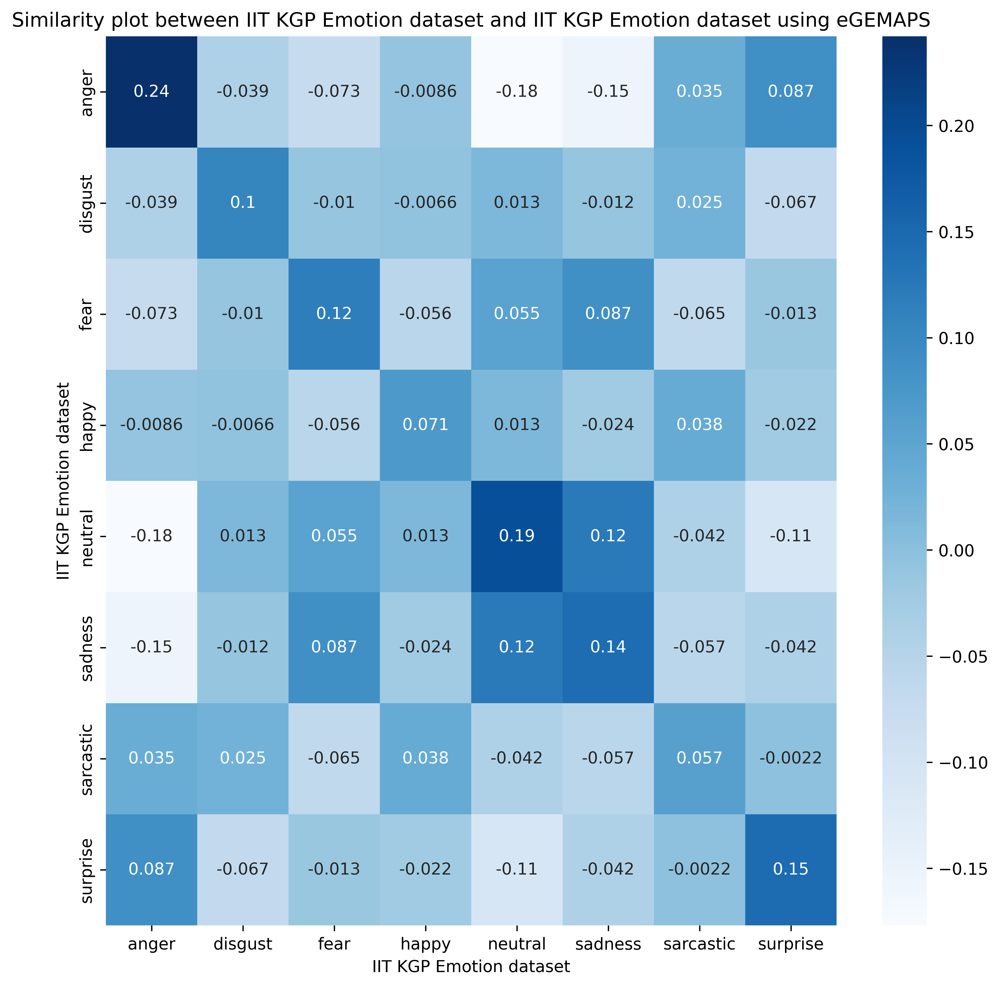

array([[ 0.24198321, -0.03949689, -0.07322457, -0.00857293, -0.1769122 ,
        -0.15443496,  0.03471885,  0.08708267],
       [-0.0394969 ,  0.10461013, -0.01013349, -0.00657043,  0.0130193 ,
        -0.01153552,  0.0252817 , -0.0668598 ],
       [-0.07322457, -0.01013349,  0.11722178, -0.05587648,  0.05463629,
         0.08709086, -0.06460383, -0.01339024],
       [-0.00857292, -0.00657043, -0.05587647,  0.07087287,  0.01304956,
        -0.02421216,  0.03844536, -0.02163283],
       [-0.17691225,  0.0130193 ,  0.05463628,  0.01304956,  0.19195133,
         0.12374575, -0.04194207, -0.1097305 ],
       [-0.15443498, -0.01153552,  0.08709087, -0.02421215,  0.12374578,
         0.14335796, -0.05701054, -0.04233228],
       [ 0.03471885,  0.02528171, -0.06460384,  0.03844536, -0.04194206,
        -0.05701054,  0.05740978, -0.00221961],
       [ 0.08708269, -0.06685981, -0.01339024, -0.02163283, -0.10973053,
        -0.0423323 , -0.00221961,  0.14513136]])

In [68]:
get_similarity_matrix(X_kgp_norm, np.array(emotion_kgp), X_kgp_norm, np.array(emotion_kgp) , xlabel = "IIT KGP Emotion dataset", ylabel="IIT KGP Emotion dataset", similarity_measure="eGEMAPS", figsize=(10,10))

## Cosine similarity between the decision scores of the datasets based on the embeddings via SVM trained on IIT KGP dataset

In [69]:
prob_sum_ravdess_kgp_based = grid_search.predict_proba(X_ravdess_norm)
prob_sum_hindi_attitude_kgp_based = grid_search.predict_proba(X_hindi_norm)
prob_sum_kgp_kgp_based = grid_search.predict_proba(X_kgp_norm)

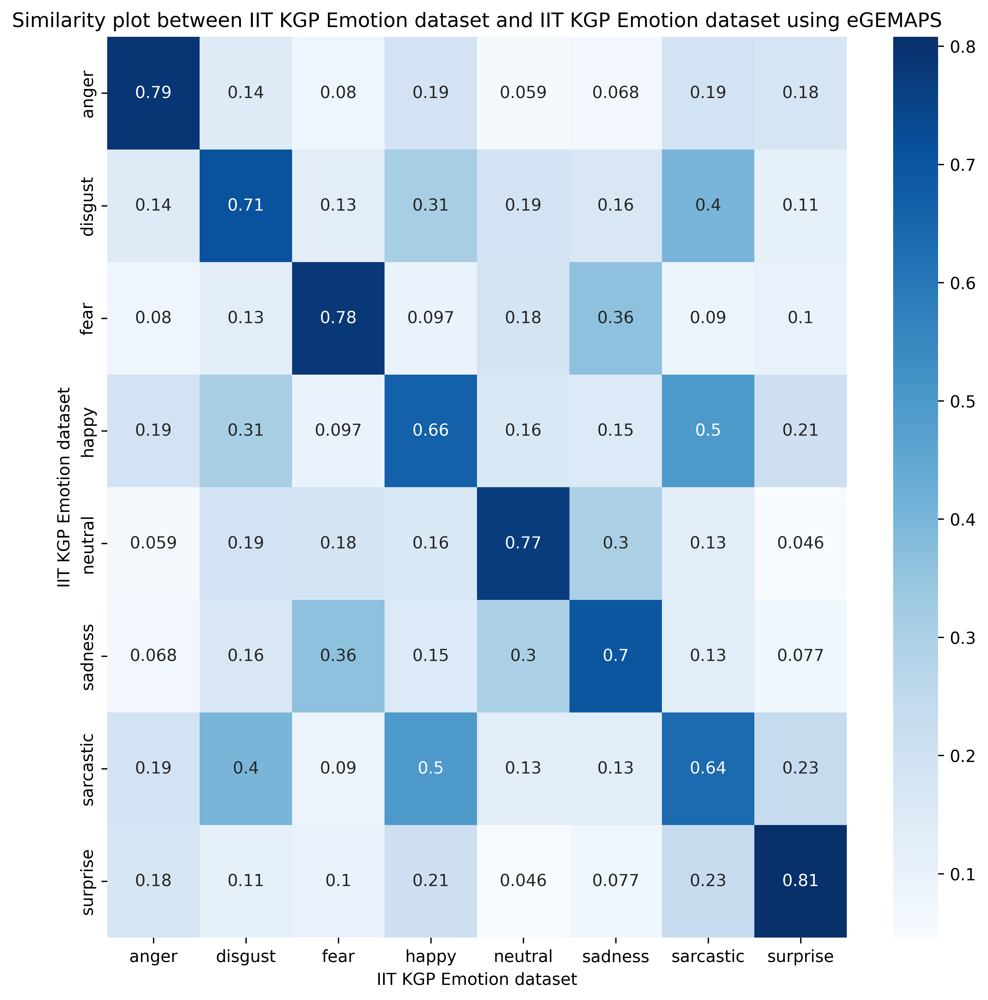

array([[0.79062992, 0.14320727, 0.07962657, 0.18734896, 0.0589831 ,
        0.06834001, 0.19037659, 0.17884544],
       [0.14320727, 0.70923307, 0.1290943 , 0.30811147, 0.18677702,
        0.16360316, 0.40100678, 0.11275057],
       [0.07962657, 0.1290943 , 0.78311233, 0.09704117, 0.18490589,
        0.36150243, 0.0903841 , 0.10084674],
       [0.18734896, 0.30811147, 0.09704117, 0.66496562, 0.16082076,
        0.15184186, 0.49680813, 0.21205794],
       [0.0589831 , 0.18677702, 0.18490589, 0.16082076, 0.77051323,
        0.30098177, 0.12896117, 0.04596046],
       [0.06834001, 0.16360316, 0.36150243, 0.15184186, 0.30098177,
        0.6973908 , 0.1308134 , 0.07701072],
       [0.19037659, 0.40100678, 0.0903841 , 0.49680813, 0.12896117,
        0.1308134 , 0.63658861, 0.2347363 ],
       [0.17884544, 0.11275057, 0.10084674, 0.21205794, 0.04596046,
        0.07701072, 0.2347363 , 0.80788231]])

In [70]:
get_similarity_matrix(prob_sum_kgp_kgp_based, np.array(emotion_kgp), prob_sum_kgp_kgp_based, np.array(emotion_kgp) , xlabel = "IIT KGP Emotion dataset", ylabel="IIT KGP Emotion dataset", similarity_measure="eGEMAPS", figsize=(10,10))

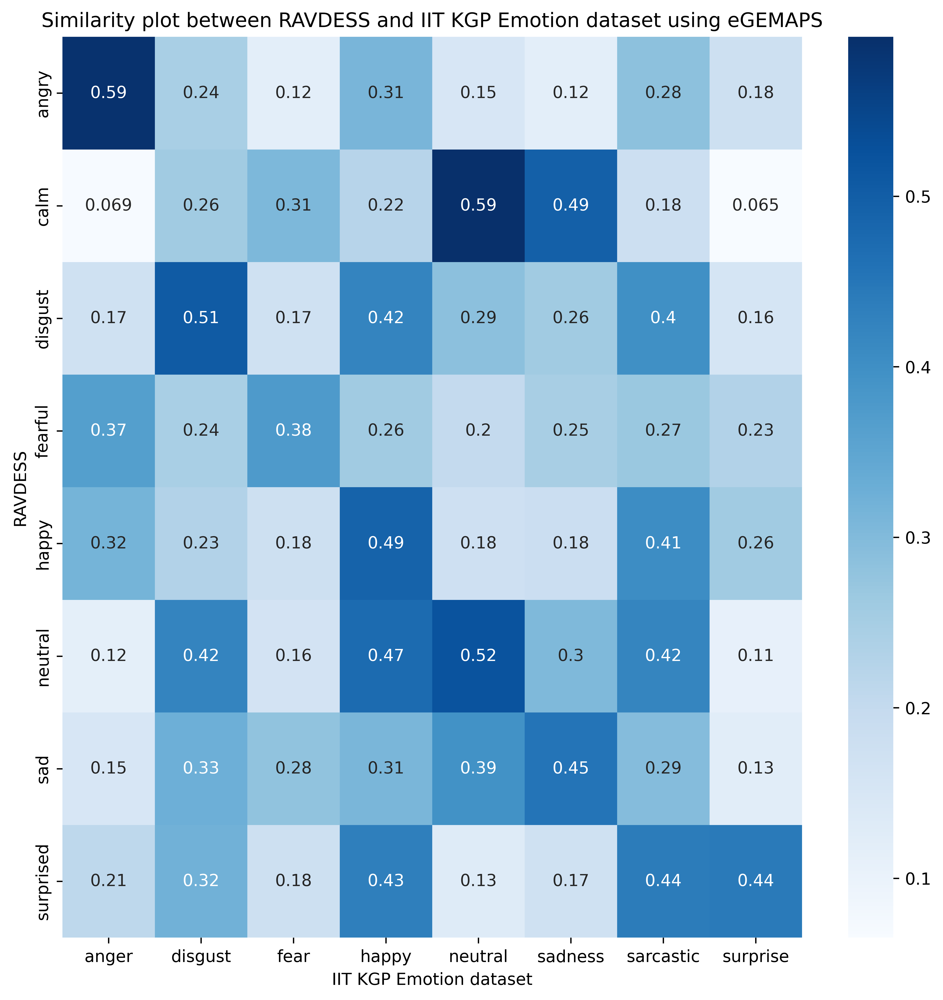

array([[0.58920839, 0.24488931, 0.11820229, 0.31209785, 0.15087809,
        0.11861925, 0.28446679, 0.17742381],
       [0.06850077, 0.25744606, 0.30551336, 0.22224945, 0.59346091,
        0.4946356 , 0.18242449, 0.06517468],
       [0.17400509, 0.50669902, 0.17337548, 0.42371582, 0.28743102,
        0.25774131, 0.39771802, 0.15645953],
       [0.36582624, 0.24487886, 0.376245  , 0.25783203, 0.20060612,
        0.24763494, 0.2682128 , 0.23195377],
       [0.31504432, 0.23171737, 0.17737472, 0.4900266 , 0.17542568,
        0.18291794, 0.40502427, 0.25894087],
       [0.11572399, 0.42252044, 0.16397208, 0.4717402 , 0.5231521 ,
        0.30358468, 0.42207715, 0.11054548],
       [0.14995377, 0.3263244 , 0.28035171, 0.30927639, 0.39431165,
        0.45422922, 0.29468546, 0.12501093],
       [0.20971545, 0.32148034, 0.17765807, 0.43389265, 0.13186609,
        0.17443705, 0.43960556, 0.44423279]])

In [71]:
get_similarity_matrix(prob_sum_kgp_kgp_based, np.array(emotion_kgp), prob_sum_ravdess_kgp_based, np.array(emotions), xlabel="IIT KGP Emotion dataset", ylabel = "RAVDESS",  similarity_measure="eGEMAPS", figsize=(10,10))

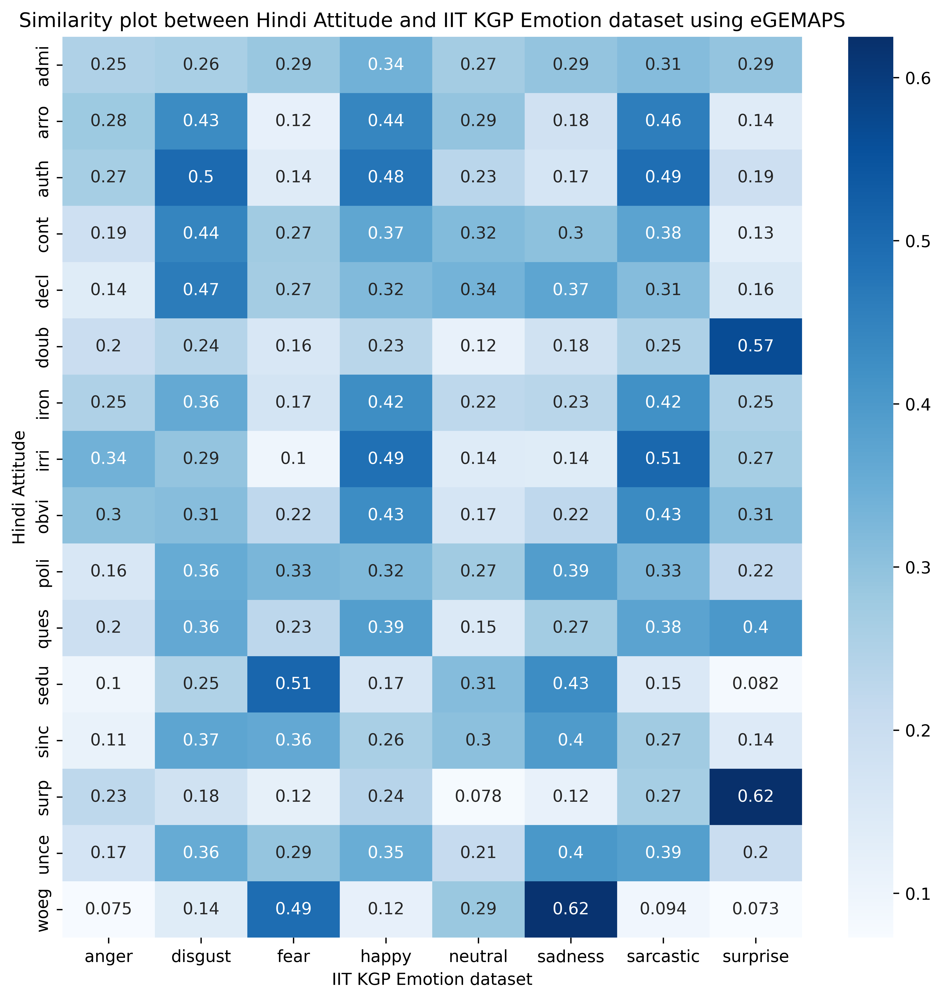

array([[0.25025252, 0.26097645, 0.28636432, 0.34090265, 0.27024422,
        0.29303713, 0.31323243, 0.29493401],
       [0.28071871, 0.43057254, 0.11818337, 0.44262811, 0.29456368,
        0.18349118, 0.45948754, 0.14074043],
       [0.26628005, 0.50036057, 0.14174638, 0.47638915, 0.23235298,
        0.16849741, 0.49326253, 0.19212335],
       [0.18921458, 0.44482089, 0.27453485, 0.37026603, 0.31716467,
        0.30198804, 0.37634207, 0.12823197],
       [0.13952135, 0.46526242, 0.26974754, 0.31977666, 0.33648671,
        0.37179385, 0.31306172, 0.15503821],
       [0.20101397, 0.2394006 , 0.15950696, 0.2332424 , 0.1151706 ,
        0.18213599, 0.25353   , 0.56569699],
       [0.25075398, 0.36160064, 0.17350924, 0.42480675, 0.22455034,
        0.23264774, 0.41925524, 0.25219868],
       [0.34226512, 0.29494005, 0.10003458, 0.48853073, 0.1433818 ,
        0.13891122, 0.50593367, 0.26622364],
       [0.30155128, 0.31025087, 0.22377051, 0.42852895, 0.16944516,
        0.22279654, 0.431619

In [72]:
get_similarity_matrix(prob_sum_kgp_kgp_based, np.array(emotion_kgp), prob_sum_hindi_attitude_kgp_based, np.array(attitude), xlabel = "IIT KGP Emotion dataset", ylabel="Hindi Attitude", similarity_measure="eGEMAPS", figsize=(10,10))

## Clustering using KNNs

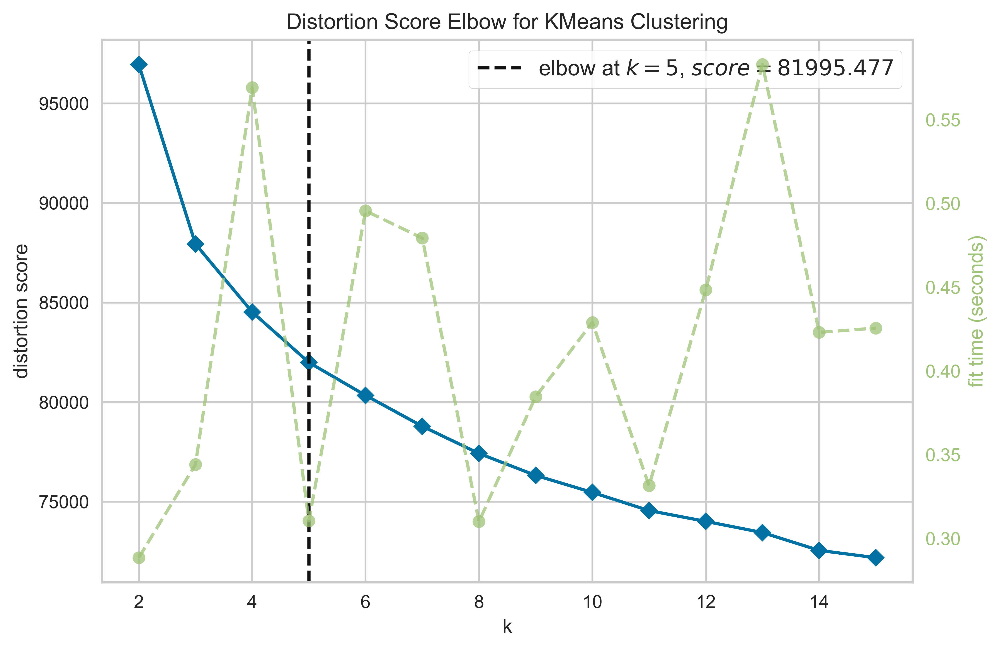

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [80]:
from yellowbrick.cluster import KElbowVisualizer
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,16))
 
visualizer.fit(X_ravdess_norm)        # Fit the data to the visualizer
visualizer.show()

In [81]:
from yellowbrick.cluster import SilhouetteVisualizer
fig, ax = plt.subplots(4, 2, figsize=(15,16))
for i in [2, 3, 4, 5, 6, 7, 8, 9]:
    '''
    Create KMeans instance for different number of clusters
    '''
    km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=42)
    q, mod = divmod(i, 2)
    '''
    Create SilhouetteVisualizer instance with KMeans instance
    Fit the visualizer
    '''
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(X_ravdess_norm) 

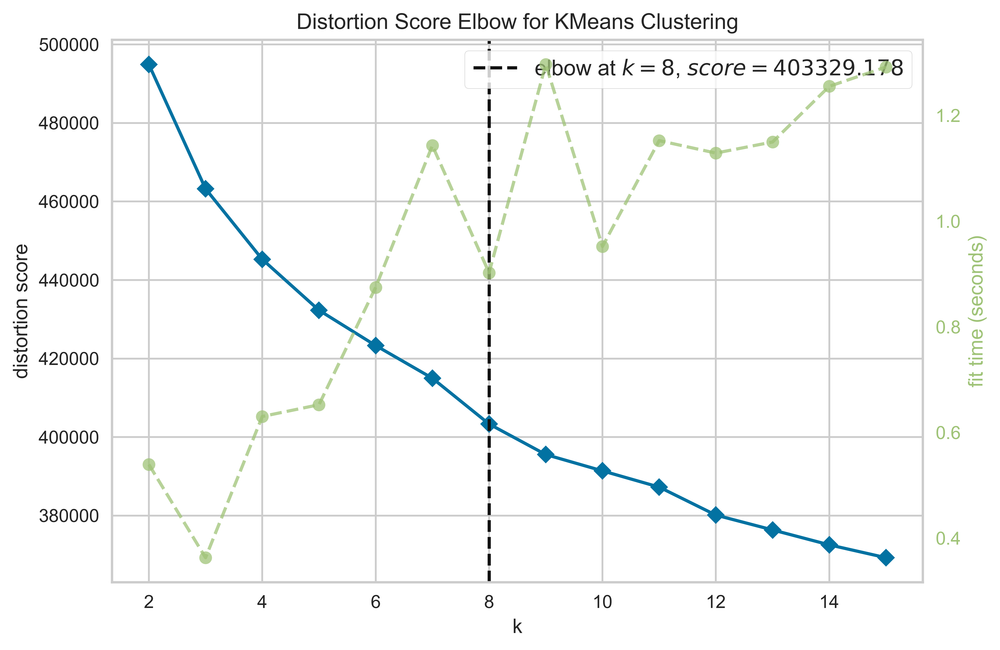

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [74]:
from yellowbrick.cluster import KElbowVisualizer
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,16))
 
visualizer.fit(X_kgp_norm)        # Fit the data to the visualizer
visualizer.show()

In [77]:
from yellowbrick.cluster import SilhouetteVisualizer
fig, ax = plt.subplots(4, 2, figsize=(15,16))
for i in [2, 3, 4, 5, 6, 7, 8, 9]:
    '''
    Create KMeans instance for different number of clusters
    '''
    km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=42)
    q, mod = divmod(i, 2)
    '''
    Create SilhouetteVisualizer instance with KMeans instance
    Fit the visualizer
    '''
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(X_kgp_norm) 

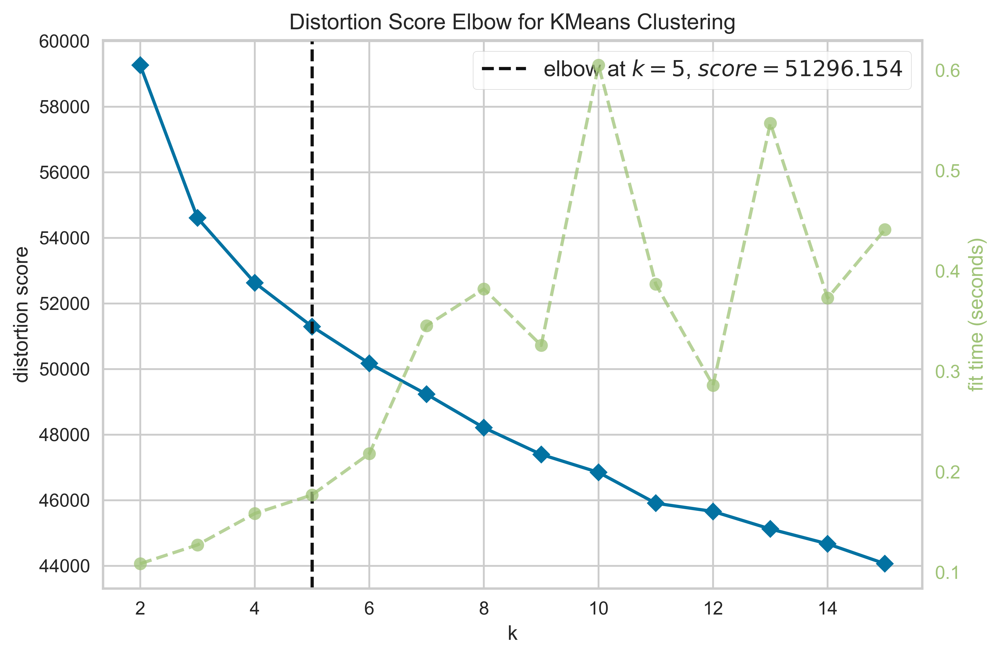

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [78]:
from yellowbrick.cluster import KElbowVisualizer
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,16))
 
visualizer.fit(X_hindi_norm)        # Fit the data to the visualizer
visualizer.show()

In [79]:
from yellowbrick.cluster import SilhouetteVisualizer
fig, ax = plt.subplots(4, 2, figsize=(15,16))
for i in [2, 3, 4, 5, 6, 7, 8, 9]:
    '''
    Create KMeans instance for different number of clusters
    '''
    km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=42)
    q, mod = divmod(i, 2)
    '''
    Create SilhouetteVisualizer instance with KMeans instance
    Fit the visualizer
    '''
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(X_hindi_norm) 